# Offline Results

## Import libraries and define util functinos

### Necessary Functions

In [2]:
import torch
import xarray as xr

def spectrum_zonally_averaged(A):
    """
    Computes the zonally averaged spectrum for a 2D matrix A.
    
    Parameters:
    - A: 2D tensor with shape (Ny, Nx). Represents the spatial data for which we want to compute the spectrum.
    
    Returns:
    - A_spec: The zonally averaged spectrum. 
    - wavenumbers: Wavenumbers corresponding to the spectrum.
    """
    
    # Compute the one-dimensional Fast Fourier Transform of A along its second dimension (dim=1).
    # rfft is used for real-valued input to obtain the non-negative frequency terms.
    A_hat = torch.fft.rfft(A, dim=1)
    
    # Take the absolute value (magnitude) of the Fourier coefficients. 
    # Then, average these magnitudes across the first dimension of A (i.e., across all rows).
    # This provides the zonally (horizontally) averaged spectrum.
    A_spec = torch.mean(torch.abs(A_hat), dim=0)
    
    # Generating wavenumbers:
    # The wavenumber represents the frequency of oscillation corresponding to each term in the Fourier series.
    # Higher wavenumbers correspond to higher frequencies (or smaller scales).
    
    Nx = A.shape[0]      # Number of rows in A
    L = 2 * torch.pi    # The length of the domain, assuming it's 2*pi (for simplicity)
    
    # rfftfreq returns the discrete wavenumbers for a real Fourier Transform, given the size Nx and spacing d.
    # Multiply by 2*pi to convert from frequencies to wavenumbers.
    # Only the first Nx//2 + 1 wavenumbers are returned as these correspond to the unique frequencies 
    # for a real-valued signal.
    wavenumbers = 2 * torch.pi * torch.fft.rfftfreq(Nx, d=L/Nx)[:Nx//2 + 1]
    
    # Ignoring Nyquist freqency (last term in wavenumbers)
                       
    return A_spec[:-1], wavenumbers[:-1]

def spectrum_xy_averaged_2D(A, direction, spectral=False):
    Nx = A.shape[0]
    Ny = A.shape[1]

    # Generating wavenumbers
    L = 2 * torch.pi
    kx = 2 * torch.pi * torch.fft.fftfreq(Nx, d=L/Nx)
    ky = 2 * torch.pi * torch.fft.fftfreq(Ny, d=L/Ny)
    wavenumber_x, wavenumber_y = torch.meshgrid(kx, ky)

    if spectral:
        A_hat = A
    else:
        A_hat = torch.fft.fft2(A)

    # Taking abs and fftshift
    A_hat = torch.abs(A_hat)
    A_hat = torch.fft.fftshift(A_hat)

    if direction[0] == 1 and direction[1] == 0:
        A_hat_mean = A_hat.mean(axis=1)
        # A_spec = torch.flip(A_hat_mean[:Ny//2]/Ny, [0])
        A_spec = torch.flip(A_hat_mean[:Ny//2], [0])
        wavenumbers = torch.arange(0, Nx // 2)
    elif direction[0] == 0 and direction[1] == 1:
        A_hat_mean = A_hat.mean(axis=0)
        # A_spec = torch.flip(A_hat_mean[:Nx//2]/Nx, [0])
        A_spec = torch.flip(A_hat_mean[:Nx//2], [0])
        wavenumbers = torch.arange(0, Ny // 2)
    else:
        raise ValueError('Direction must be [1,0] or [0,1]')
    
    return A_spec, wavenumbers


### Post Process class

In [3]:
import torch
from utils.corr2 import corr2
# !pip install xarray
# !pip install netcdf4
import xarray as xr

class DataProcessor:
    def __init__(self, data_path):
        self.data_path = data_path
        self.pred = None
        self.true = None
        self.input = None
        self.num_samples = None

    def load_data(self):
        # Load data
        data = xr.open_dataset(self.data_path)

        # Get data
        self.pred = data['prediction']
        self.true = data['true']
        self.input = data['inputs']

        # Convert to torch tensor
        self.pred = torch.tensor(self.pred.values)
        self.true = torch.tensor(self.true.values)
        self.input = torch.tensor(self.input.values)
        self.num_samples = self.pred.shape[0]

        # Close the file
        data.close()

    def get_data(self):
        return self.input, self.true, self.pred, self.num_samples
    
    def calc_cc(self, scale):
        self.cc = torch.zeros(self.num_samples, 2)
        for index in range(self.num_samples):
            for channel in range(2):
                self.cc[index, channel] = corr2(self.true[index, channel]*scale, self.pred[index, channel]*scale)
    
    def calc_rmse(self):
        self.rmse = torch.zeros(self.num_samples, 2)
        for index in range(self.num_samples):
            for channel in range(2):
                self.rmse[index, channel] = torch.sqrt(torch.mean((self.true[index, channel] - self.pred[index, channel])**2)) / torch.norm(self.true[index, channel], p=2)
    
    def calc_spec(self):
        self.model_spec = torch.zeros((self.num_samples, 2, 32))
        self.true_spec = torch.zeros((self.num_samples, 2, 32))
        self.input_spec = torch.zeros((self.num_samples, 4, 32))
        
        for i in range(self.num_samples):
            for j in range(2):
                self.model_spec[i, j], self.km = spectrum_zonally_averaged(self.pred[i,j])
                self.true_spec[i, j], self.kt = spectrum_zonally_averaged(self.true[i,j])

        for i in range(self.num_samples):
            for j in range(4):
                self.input_spec[i, j], self.kinput = spectrum_zonally_averaged(self.input[i,j])
    

import torch
import h5py

class DataProcessor_mat:
    def __init__(self, data_path):
        self.data_path = data_path
        self.pred = None
        self.true = None
        self.num_samples = None

    def load_data(self):
        # Load data
        with h5py.File(self.data_path, 'r') as f:
            self.pred = f['predicted_output'][:].T
            self.true = f['target_output'][:].T

        # Convert to torch tensor
        self.pred = torch.tensor(self.pred)
        self.true = torch.tensor(self.true)
        self.num_samples = self.pred.shape[0]

    def get_data(self):
        return self.true, self.pred, self.num_samples
    
    def calc_cc(self, scale):
        self.cc = torch.zeros(self.num_samples, 2)
        for index in range(self.num_samples):
            for channel in range(2):
                self.cc[index, channel] = corr2(self.true[index, channel]*scale, self.pred[index, channel]*scale)
        
    def calc_rmse(self):
        self.rmse = torch.zeros(self.num_samples, 2)
        for index in range(self.num_samples):
            for channel in range(2):
                self.rmse[index, channel] = torch.sqrt(torch.mean((self.true[index, channel] - self.pred[index, channel])**2)) / torch.norm(self.true[index, channel], p=2)
                
    def calc_spec(self):
        self.model_spec = torch.zeros((self.num_samples, 2, 32))
        self.true_spec = torch.zeros((self.num_samples, 2, 32))
        self.input_spec = torch.zeros((self.num_samples, 4, 32))

        for i in range(self.num_samples):
            for j in range(2):
                self.model_spec[i, j], self.km = spectrum_zonally_averaged(self.pred[i,j])
                self.true_spec[i, j], self.kt = spectrum_zonally_averaged(self.true[i,j])

        # for i in range(self.num_samples):
        #     for j in range(4):
        #         self.input_spec[i, j], self.kinput = spectrum_zonally_averaged(self.input[i,j])


## Loading offline data

In [4]:
# Trained BASE system
# change directory to the root of the project
import os
os.chdir('/media/volume/sdc/qg/TransferLearning-QG')

BNN = DataProcessor('results/BNN/output.nc')
BNN.load_data()

Case2 = DataProcessor('results/Case2/output.nc')
Case2.load_data()

Case2_with_better = DataProcessor('results/test_case2_with_better_data/output.nc')
Case2_with_better.load_data()

Case3 = DataProcessor('results/Case3/output.nc')
Case3.load_data()

Case4 = DataProcessor('results/Case4/output.nc')
Case4.load_data()

# TLNN 
# -------------------------------------------------- Case 2 --------------------------------------------------
bnn_case2_2p = DataProcessor('results/bnn_case2_2p/output.nc')
bnn_case2_2p.load_data()

bnn_case2_5p = DataProcessor('results/bnn_case2_5p/output.nc')
bnn_case2_5p.load_data()

bnn_case2_10p = DataProcessor('results/bnn_case2_10p/output.nc')
bnn_case2_10p.load_data()

bnn_case2_2p_new = DataProcessor('results/bnn_case2_2p_new/output.nc')
bnn_case2_2p_new.load_data()

bnn_case2_5p_new = DataProcessor('results/bnn_case2_5p_new/output.nc')
bnn_case2_5p_new.load_data()

bnn_case2_10p_new = DataProcessor('results/bnn_case2_10p_new/output.nc')
bnn_case2_10p_new.load_data()

# -------------------------------------------------- Case 3 --------------------------------------------------
bnn_case3_2p = DataProcessor('results/bnn_case3_2p/output.nc')
bnn_case3_2p.load_data()

bnn_case3_5p = DataProcessor('results/bnn_case3_5p/output.nc')
bnn_case3_5p.load_data()

bnn_case3_10p = DataProcessor('results/bnn_case3_10p/output.nc')
bnn_case3_10p.load_data()
# -------------------------------------------------- Case 4 --------------------------------------------------
bnn_case4_2p = DataProcessor('results/bnn_case4_2p/output.nc')
bnn_case4_2p.load_data()

bnn_case4_5p = DataProcessor('results/bnn_case4_5p/output.nc')
bnn_case4_5p.load_data()

bnn_case4_10p = DataProcessor('results/bnn_case4_10p/output.nc')
bnn_case4_10p.load_data()

# Direct inference
inf_bnn_case2 = DataProcessor('results/inf_bnn_case2/output.nc')
inf_bnn_case2.load_data()

inf_bnn_case2_new = DataProcessor('results/inf_bnn_case2_new/output.nc')
inf_bnn_case2_new.load_data()

inf_bnn_case3 = DataProcessor('results/inf_bnn_case3/output.nc')
inf_bnn_case3.load_data()

inf_bnn_case4 = DataProcessor('results/inf_bnn_case4/output.nc')
inf_bnn_case4.load_data()

# -------------------------------------------------- One-shot TL --------------------------------------------------

bnn_case2_1sp = DataProcessor('results/bnn_case2_1sp/output.nc')
bnn_case2_1sp.load_data()

bnn_case3_1sp = DataProcessor('results/bnn_case3_1sp/output.nc')
bnn_case3_1sp.load_data()

bnn_case4_1sp = DataProcessor('results/bnn_case4_1sp/output.nc')
bnn_case4_1sp.load_data()

# -------------------------------------------------- Redo-cases --------------------------------------------------
bnn_case3_1sp_redo = DataProcessor('results/bnn_case3_1sp_redo/output.nc')
bnn_case3_1sp_redo.load_data()

bnn_case2_10p_redo = DataProcessor('results/bnn_case2_10p_redo/output.nc')
bnn_case2_10p_redo.load_data()



## Metrics calculation

In [5]:
# Calc CC, RMSE, and spectrum for all models
model_list = [
             BNN, Case2, Case3, Case4, Case2_with_better,
             bnn_case2_2p,bnn_case2_5p,bnn_case2_10p,
             bnn_case3_2p,bnn_case3_5p,bnn_case3_10p,
             bnn_case4_2p,bnn_case4_5p,bnn_case4_10p,
             bnn_case2_2p_new,bnn_case2_5p_new,bnn_case2_10p_new,
             inf_bnn_case2, inf_bnn_case3, inf_bnn_case4, inf_bnn_case2_new,
             bnn_case2_1sp, bnn_case3_1sp, bnn_case4_1sp,
             bnn_case3_1sp_redo,bnn_case2_10p_redo
             ]
for model in model_list:
    model.calc_cc(scale=1000)
    model.calc_spec()
    model.calc_rmse()

First 1 snapshot of Case3 was with index 70, second one was with index 86 of the dataset. So it's really dependant of index for 1-snapshot TL.


In [ ]:
channel = 0

def relative_spec_error(model1, model2, channel):
    # Model 2 is thes base model
    model1_spec = model1.model_spec[:,channel].mean(axis=0)
    model2_spec = model2.true_spec[:,channel].mean(axis=0)
    return ((abs(model1_spec-model2_spec))/(model2_spec)).mean()

def spec_rmse(spec1, spec2):
    return torch.sqrt(torch.mean((spec1-spec2)**2, dim=(1)))


def get_q_0(instance):
    for name, val in globals().items():
        if val is instance:
            return name
    for name, val in locals().items():
        if val is instance:
            return name
    return None



for model in model_list:
    print(get_q_0(model))
    print(spec_rmse(model.model_spec[:,1], model.true_spec[:,1]).mean())
    print(spec_rmse(model.model_spec[:,1], model.true_spec[:,1]).std())




BNN
tensor(2.2066e-14)
tensor(5.2722e-15)
Case2
tensor(7.0592e-15)
tensor(5.0101e-15)
Case3
tensor(2.2969e-15)
tensor(8.5994e-16)
Case4
tensor(7.6009e-15)
tensor(3.0123e-15)
Case2_with_better
tensor(8.2860e-15)
tensor(3.3367e-15)
bnn_case2_2p
tensor(9.9917e-15)
tensor(6.5866e-15)
bnn_case2_5p
tensor(1.3191e-14)
tensor(1.2203e-14)
bnn_case2_10p
tensor(9.3898e-15)
tensor(5.2073e-15)
bnn_case3_2p
tensor(1.4585e-15)
tensor(3.6966e-16)
bnn_case3_5p
tensor(1.3862e-15)
tensor(5.7819e-16)
bnn_case3_10p
tensor(1.4801e-15)
tensor(6.2849e-16)
bnn_case4_2p
tensor(1.0628e-14)
tensor(2.9646e-15)
bnn_case4_5p
tensor(1.8663e-14)
tensor(3.5648e-15)
bnn_case4_10p
tensor(1.0254e-14)
tensor(3.6261e-15)
bnn_case2_2p_new
tensor(1.0659e-14)
tensor(2.3444e-15)
bnn_case2_5p_new
tensor(1.1147e-14)
tensor(3.6029e-15)
bnn_case2_10p_new
tensor(1.0440e-14)
tensor(3.4297e-15)
inf_bnn_case2
tensor(4.8684e-14)
tensor(2.8013e-14)
inf_bnn_case3
tensor(2.9274e-14)
tensor(6.5353e-15)
inf_bnn_case4
tensor(6.6776e-14)
tenso

In [19]:
model = bnn_case3_1sp_redo
model.calc_cc(scale=1000)
model.calc_spec()
model.calc_rmse()

print(model.cc.mean(axis=0))
print(model.cc.std(axis=0))
print(model.rmse.mean(axis=0))
print(model.rmse.std(axis=0))
print(spec_rmse(model.model_spec[:,0], model.true_spec[:,0]).mean())
print(spec_rmse(model.model_spec[:,0], model.true_spec[:,0]).std())
print(spec_rmse(model.model_spec[:,1], model.true_spec[:,1]).mean())
print(spec_rmse(model.model_spec[:,1], model.true_spec[:,1]).std())

tensor([0.9044, 0.9596])
tensor([0.0115, 0.0028])
tensor([0.0067, 0.0048])
tensor([0.0004, 0.0003])
tensor(1.2601e-12)
tensor(2.7175e-13)
tensor(1.0394e-14)
tensor(2.5985e-15)


## Figure1. 

### Snapshot of q

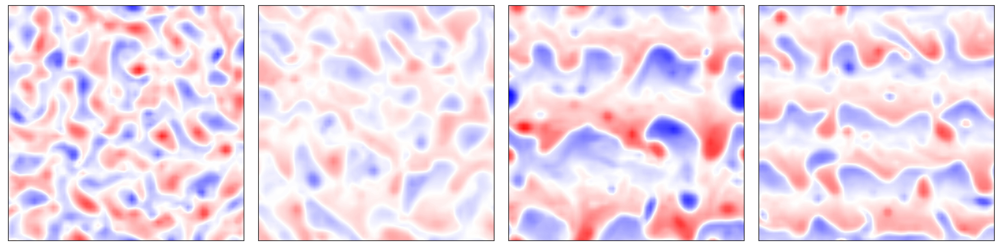

In [9]:
import xarray as xr
import matplotlib.pyplot as plt
from matplotlib import ticker
# from matplotlib.colors import DivergingNorm
import numpy as np

# Your data loading code here
file_eddy = xr.open_dataset("/media/volume/sdc/qg/TransferLearning-QG/results/Snapshots/eddy/120.nc")
file_3jet = xr.open_dataset("/media/volume/sdc/qg/TransferLearning-QG/results/Snapshots/3jet/120.nc")
file_4jet = xr.open_dataset("/media/volume/sdc/qg/TransferLearning-QG/results/Snapshots/4jet/120.nc")
file_eddy_rd = xr.open_dataset("/media/volume/sdc/qg/TransferLearning-QG/results/Snapshots/eddy_radius_20000/120.nc")

# Your plotting code
fig, ax = plt.subplots(1, 4, figsize=(18, 5), dpi=500)
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16
plt.rcParams['axes.labelweight'] = 'bold'

plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'

# Create a list of data arrays
data_arrays = [
    file_eddy['q'].isel(time=86, lev=0),
    file_eddy_rd['q'].isel(time=86, lev=0),
    file_3jet['q'].isel(time=86, lev=0),
    file_4jet['q'].isel(time=86, lev=0)
]

# Calculate the global min and max across all data arrays
global_min = min([data.min() for data in data_arrays])
global_max = max([data.max() for data in data_arrays])

# Get the absolute maximum value to center the colormap at zero
abs_max = max(abs(global_min), abs(global_max))

# Choose a colormap
cmap = plt.get_cmap('bwr')

# List to store the contour objects
contours = []

# Plot each data array with the global color scale limits and the diverging norm
contours.append(ax[0].contourf(data_arrays[0], cmap=cmap, levels=np.linspace(-abs_max, abs_max, 400)))
# ax[0].set_title(r'Case 0: Eddy Configuration \newline $\beta^{0} = 1.5\times10^{-11} [\frac{1}{ms}]$ \newline $\delta^{0} = 0.25 [-]$ \newline $r_{ek}^{0} = 5.78\times10^{-7} [\frac{1}{s}]$ \newline $r_{d}^{0} = 15000  [m]$', fontsize=14, style='italic')

# ax[0].set_title(r'Case 0: Eddy Configuration, $\beta^{\text{Case 0}} = 1.5\times10^{-11} \, \frac{1}{ms}$', fontsize=18)
contours.append(ax[1].contourf(data_arrays[1], cmap=cmap, levels=np.linspace(-abs_max, abs_max, 400)))
# ax[1].set_title(r'Case 1: Eddy with higher $r_d$', fontsize=18)

contours.append(ax[2].contourf(data_arrays[2], cmap=cmap, levels=np.linspace(-abs_max, abs_max, 400)))
# ax[2].set_title(r'Case 2: 3-jet Configuration', fontsize=18)

contours.append(ax[3].contourf(data_arrays[3], cmap=cmap, levels=np.linspace(-abs_max, abs_max, 400)))
# ax[3].set_title(r'Case 3: 4-jet Configuration', fontsize=18)

# Remove axis ticks
for axis in ax.flatten():
    axis.set_xticks([])
    axis.set_yticks([])
    axis.set_aspect('equal')

# Add a colorbar to the last column
# cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
# cbar = fig.colorbar(contours[3], cax=cbar_ax)

# Function to set pretty ticks for colorbar
def pretty_cbar_ticks(cbar):
    cbar.locator = ticker.MaxNLocator(nbins=7)
    cbar.update_ticks()


plt.tight_layout()
plt.show()


### Snapshot of SGS

/tmp/ipykernel_121893/100953487.py:78: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


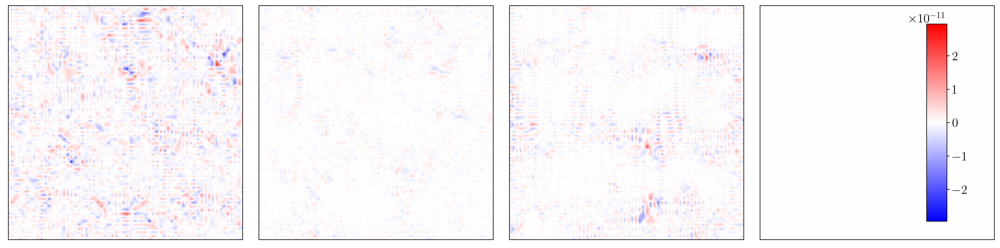

In [7]:
import xarray as xr
import matplotlib.pyplot as plt
from matplotlib import ticker
# from matplotlib.colors import DivergingNorm
import numpy as np

# Your data loading code here
file_eddy = xr.open_dataset("/media/volume/sdc/qg/TransferLearning-QG/results/Snapshots/eddy/120.nc")
file_3jet = xr.open_dataset("/media/volume/sdc/qg/TransferLearning-QG/results/Snapshots/3jet/120.nc")
file_4jet = xr.open_dataset("/media/volume/sdc/qg/TransferLearning-QG/results/Snapshots/4jet/120.nc")
file_eddy_rd = xr.open_dataset("/media/volume/sdc/qg/TransferLearning-QG/results/Snapshots/eddy_radius_20000/120.nc")

# Your plotting code
fig, ax = plt.subplots(1, 4, figsize=(18, 5), dpi=500)
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 16
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16
plt.rcParams['axes.labelweight'] = 'bold'

plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'

# Create a list of data arrays
data_arrays = [
    file_eddy['q_forcing_advection'].isel(time=86, lev=0),
    file_eddy_rd['q_forcing_advection'].isel(time=86, lev=0),
    file_3jet['q_forcing_advection'].isel(time=86, lev=0),
    file_4jet['q_forcing_advection'].isel(time=86, lev=0)
]

# Calculate the global min and max across all data arrays
global_min = min([data.min() for data in data_arrays])
global_max = max([data.max() for data in data_arrays])

# Get the absolute maximum value to center the colormap at zero
abs_max = max(abs(global_min), abs(global_max))

# Choose a colormap
cmap = plt.get_cmap('bwr')

# List to store the contour objects
contours = []

# Plot each data array with the global color scale limits and the diverging norm
contours.append(ax[0].contourf(data_arrays[0], cmap=cmap, levels=np.linspace(-abs_max, abs_max, 400)))
# ax[0].set_title(r'Case 0: Eddy Configuration', fontsize=18)

contours.append(ax[1].contourf(data_arrays[1], cmap=cmap, levels=np.linspace(-abs_max, abs_max, 400)))
# ax[1].set_title(r'Case 1: Eddy with higher $r_d$', fontsize=18)

contours.append(ax[2].contourf(data_arrays[2], cmap=cmap, levels=np.linspace(-abs_max, abs_max, 400)))
# ax[2].set_title(r'Case 2: 3-jet Configuration', fontsize=18)

contours.append(ax[3].contourf(0*data_arrays[3], cmap=cmap, levels=np.linspace(-abs_max, abs_max, 400)))
# ax[3].set_title(r'Case 3: 4-jet Configuration', fontsize=18)

# Remove axis ticks
for axis in ax.flatten():
    axis.set_xticks([])
    axis.set_yticks([])
    axis.set_aspect('equal')

# Add a colorbar to the last column
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(contours[3], cax=cbar_ax)

# Function to set pretty ticks for colorbar
def pretty_cbar_ticks(cbar):
    cbar.locator = ticker.MaxNLocator(nbins=7)
    cbar.update_ticks()

pretty_cbar_ticks(cbar)

plt.tight_layout()
plt.show()


### Input spectrum

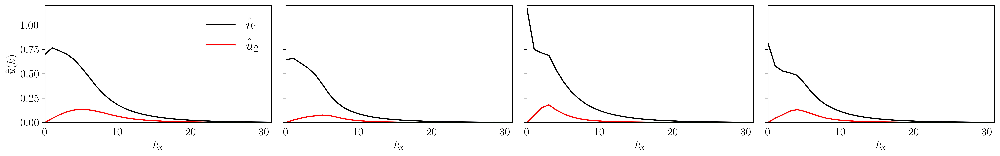

In [ ]:
fig = plt.figure(figsize=(18,3), dpi=600)

# Create a GridSpec instance with 1 row and 4 columns, and custom width ratios
gs = gridspec.GridSpec(1, 4, width_ratios=[1, 1, 1, 1])  # Adjust the ratios as needed

# Create subplots with custom size ratios
ax = []
ax.append(plt.subplot(gs[0, 0]))
ax.append(plt.subplot(gs[0, 1]))
ax.append(plt.subplot(gs[0, 2]))
ax.append(plt.subplot(gs[0, 3]))

plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14

ax[0].plot(BNN.kinput, BNN.input_spec[:,0].mean(axis=0).T, label=r'$\hat{\bar{u}}_1$', color='black')
ax[0].plot(BNN.kinput, BNN.input_spec[:,3].mean(axis=0).T, label=r'$\hat{\bar{u}}_2$'  , color='red')

ax[1].plot(Case3.kinput, Case3.input_spec[:,0].mean(axis=0).T, label=r'$\hat{\bar{u}}_1$', color='black')
ax[1].plot(Case3.kinput, Case3.input_spec[:,3].mean(axis=0).T, label=r'$\hat{\bar{u}}_2$'  , color='red')

ax[2].plot(Case2_with_better.kinput, Case2_with_better.input_spec[:,0].mean(axis=0).T, label=r'$\hat{\bar{u}}_1$', color='black')
ax[2].plot(Case2_with_better.kinput, Case2_with_better.input_spec[:,3].mean(axis=0).T, label=r'$\hat{\bar{u}}_2$'  , color='red')

ax[3].plot(Case4.kinput, Case4.input_spec[:,0].mean(axis=0).T, label=r'$\hat{\bar{u}}_1$', color='black')
ax[3].plot(Case4.kinput, Case4.input_spec[:,3].mean(axis=0).T, label=r'$\hat{\bar{u}}_2$'  , color='red')


for i in range(4):
    ax[i].set_xlim(0, 31)
    ax[i].set_ylim(0, 1.2)
    ax[i].set_xlabel('$k_x$')

ax[0].set_ylabel(r"$\hat{\bar{u}}(k)$")
ax[0].legend(fontsize = 18, loc='best', frameon=False)
# Turn off yticklabels
ax[1].set_yticklabels([])
ax[2].set_yticklabels([])
ax[3].set_yticklabels([])

plt.tight_layout()
plt.show()

### Output spectrum (True data)

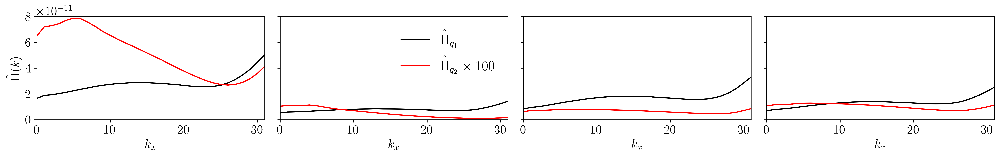

In [10]:
# Create a GridSpec instance with 2 rows and 2 columns, and equal width and height for each subplot

import matplotlib.gridspec as gridspec

# Create a figure instance
fig = plt.figure(figsize=(18,3), dpi=600)

# Create a GridSpec instance with 1 row and 4 columns, and custom width ratios
gs = gridspec.GridSpec(1, 4, width_ratios=[1, 1, 1, 1])  # Adjust the ratios as needed

# Create subplots with custom size ratios
ax = []
ax.append(plt.subplot(gs[0, 0]))
ax.append(plt.subplot(gs[0, 1]))
ax.append(plt.subplot(gs[0, 2]))
ax.append(plt.subplot(gs[0, 3]))
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14

ax[0].plot(BNN.kt, BNN.true_spec[:,0].mean(axis=0).T, label=r'$\hat{\bar{{\Pi}}}_{q_1}$', color='black')
ax[0].plot(BNN.kt, BNN.true_spec[:,1].mean(axis=0).T*100, label=r'$\hat{\bar{{\Pi}}}_{q_2} \times 100$', color='red')

ax[1].plot(Case3.kt, Case3.true_spec[:,0].mean(axis=0).T, label=r'$\hat{\bar{{\Pi}}}_{q_1}$' , color='black')
ax[1].plot(Case3.kt, Case3.true_spec[:,1].mean(axis=0).T*100, label=r'$\hat{\bar{{\Pi}}}_{q_2} \times 100$' , color='red')

ax[2].plot(Case2_with_better.kt, Case2_with_better.true_spec[:,0].mean(axis=0).T, label=r'$\hat{\bar{{\Pi}}}_{q_1}$', color='black')
ax[2].plot(Case2_with_better.kt, Case2_with_better.true_spec[:,1].mean(axis=0).T*100, label=r'$\hat{\bar{{\Pi}}}_{q_2} \times 100$', color='red')

ax[3].plot(Case4.kt, Case4.true_spec[:,0].mean(axis=0).T, label=r'$\hat{\bar{{\Pi}}}_{q_1}$', color='black')
ax[3].plot(Case4.kt, Case4.true_spec[:,1].mean(axis=0).T*100, label=r'$\hat{\bar{{\Pi}}}_{q_2} \times 100$', color='red')


for i in range(4):
    
    ax[i].set_xlim(0, 31)
    ax[i].set_ylim(0, 8e-11)
    ax[i].set_xlabel('$k_x$')
    # ax[i].set_yscale('log')
    # ax[i].grid(True, which="both", ls="-")

ax[0].set_ylabel(r"$\hat{\bar{{\Pi}}}(k)$")
ax[1].legend(fontsize = 18, loc='best', frameon=False)
ax[1].set_yticklabels([])
ax[2].set_yticklabels([])
ax[3].set_yticklabels([])
# ax[0].set_xlabel(r"Wavenumber $(m^{-1})$")
# ax[0].set_ylabel("Spectrum", fontsize=16)
# Set equal
plt.tight_layout()
plt.show()


## Figure 3

### Output spectrum of BNN and TLNN

#### 
Case 1: Eddy with higher deformation Radius, 
Case2: 3 Jet, 
Case3: 4Jet

In [12]:
# Create a GridSpec instance with 2 rows and 2 columns, and equal width and height for each subplot
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Create a figure instance
fig = plt.figure(figsize=(18,3), dpi=1200)

# Create a GridSpec instance with 1 row and 4 columns, and custom width ratios
gs = gridspec.GridSpec(1, 3, width_ratios=[1, 1, 1])  # Adjust the ratios as needed

# Create subplots with custom size ratios
ax = []
ax.append(plt.subplot(gs[0, 0]))
ax.append(plt.subplot(gs[0, 1]))
ax.append(plt.subplot(gs[0, 2]))

plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14

ax[0].plot(Case3.kt, Case3.true_spec[:,0].mean(axis=0).T, label=r'$FDNS$', color='gray', linewidth=4, alpha=0.5)

ax[0].plot(inf_bnn_case3.km, inf_bnn_case3.model_spec[:,0].mean(axis=0).T, label=r'$BNN^{0}$', color='red', linewidth=2, alpha=0.5)
ax[0].fill_between(inf_bnn_case3.km, inf_bnn_case3.model_spec[:,0].mean(axis=0).T - inf_bnn_case3.model_spec[:,0].std(axis=0).T, inf_bnn_case3.model_spec[:,0].mean(axis=0).T + inf_bnn_case3.model_spec[:,0].std(axis=0).T, color='red', alpha=0.1)
ax[0].plot(bnn_case3_1sp.km, bnn_case3_1sp.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,1}_{0\%}$', color='blue', linewidth=2, alpha=0.25)
ax[0].fill_between(bnn_case3_1sp.km, bnn_case3_1sp.model_spec[:,0].mean(axis=0).T - bnn_case3_1sp.model_spec[:,0].std(axis=0).T, bnn_case3_1sp.model_spec[:,0].mean(axis=0).T + bnn_case3_1sp.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.05)
ax[0].plot(bnn_case3_2p.km, bnn_case3_2p.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,1}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[0].fill_between(bnn_case3_2p.km, bnn_case3_2p.model_spec[:,0].mean(axis=0).T - bnn_case3_2p.model_spec[:,0].std(axis=0).T, bnn_case3_2p.model_spec[:,0].mean(axis=0).T + bnn_case3_2p.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.1)
ax[0].plot(bnn_case3_10p.km, bnn_case3_10p.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,1}_{10\%}$', color='blue', linewidth=2, alpha=1)
ax[0].fill_between(bnn_case3_10p.km, bnn_case3_10p.model_spec[:,0].mean(axis=0).T - bnn_case3_10p.model_spec[:,0].std(axis=0).T, bnn_case3_10p.model_spec[:,0].mean(axis=0).T + bnn_case3_10p.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.2)


ax[1].plot(Case2_with_better.kt, Case2_with_better.true_spec[:,0].mean(axis=0).T, label=r'$FDNS$', color='gray', linewidth=4, alpha=0.5)

ax[1].plot(inf_bnn_case2_new.km, inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T, label=r'$BNN^{0}$', color='red', linewidth=2, alpha=0.5)
ax[1].fill_between(inf_bnn_case2_new.km, inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T - inf_bnn_case2_new.model_spec[:,0].std(axis=0).T, inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T + inf_bnn_case2_new.model_spec[:,0].std(axis=0).T, color='red', alpha=0.1)
ax[1].plot(bnn_case2_1sp.km, bnn_case2_1sp.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,2}_{0\%}$', color='blue', linewidth=2, alpha=0.25)
ax[1].fill_between(bnn_case2_1sp.km, bnn_case2_1sp.model_spec[:,0].mean(axis=0).T - bnn_case2_1sp.model_spec[:,0].std(axis=0).T, bnn_case2_1sp.model_spec[:,0].mean(axis=0).T + bnn_case2_1sp.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.05)
ax[1].plot(bnn_case2_2p_new.km, bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,2}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[1].fill_between(bnn_case2_2p_new.km, bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T - bnn_case2_2p_new.model_spec[:,0].std(axis=0).T, bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T + bnn_case2_2p_new.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.1)
ax[1].plot(bnn_case2_10p_new.km, bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,2}_{10\%}$', color='blue', linewidth=2, alpha=1)
ax[1].fill_between(bnn_case2_10p_new.km, bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T - bnn_case2_10p_new.model_spec[:,0].std(axis=0).T, bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T + bnn_case2_10p_new.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.2)


ax[2].plot(Case4.kt, Case4.true_spec[:,0].mean(axis=0).T, label=r'$FDNS$', color='gray', linewidth=4, alpha=0.5)

ax[2].plot(inf_bnn_case4.km, inf_bnn_case4.model_spec[:,0].mean(axis=0).T, label=r'$BNN^{0}$', color='red', linewidth=2, alpha=0.5)
ax[2].fill_between(inf_bnn_case4.km, inf_bnn_case4.model_spec[:,0].mean(axis=0).T - inf_bnn_case4.model_spec[:,0].std(axis=0).T, inf_bnn_case4.model_spec[:,0].mean(axis=0).T + inf_bnn_case4.model_spec[:,0].std(axis=0).T, color='red', alpha=0.1)
ax[2].plot(bnn_case4_1sp.km, bnn_case4_1sp.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,3}_{0\%}$', color='blue', linewidth=2, alpha=0.25)
ax[2].fill_between(bnn_case4_1sp.km, bnn_case4_1sp.model_spec[:,0].mean(axis=0).T - bnn_case4_1sp.model_spec[:,0].std(axis=0).T, bnn_case4_1sp.model_spec[:,0].mean(axis=0).T + bnn_case4_1sp.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.05)
ax[2].plot(bnn_case4_2p.km, bnn_case4_2p.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,3}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[2].fill_between(bnn_case4_2p.km, bnn_case4_2p.model_spec[:,0].mean(axis=0).T - bnn_case4_2p.model_spec[:,0].std(axis=0).T, bnn_case4_2p.model_spec[:,0].mean(axis=0).T + bnn_case4_2p.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.1)
ax[2].plot(bnn_case4_10p.km, bnn_case4_10p.model_spec[:,0].mean(axis=0).T, label=r'$TLNN^{0,3}_{10\%}$', color='blue', linewidth=2, alpha=1)
ax[2].fill_between(bnn_case4_10p.km, bnn_case4_10p.model_spec[:,0].mean(axis=0).T - bnn_case4_10p.model_spec[:,0].std(axis=0).T, bnn_case4_10p.model_spec[:,0].mean(axis=0).T + bnn_case4_10p.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.2)

for i in range(3):
    
    ax[i].set_xlim(0, 31)
    ax[i].set_ylim(0, 3.5e-11)
    ax[i].set_xlabel('$\kappa_x$')
    # ax[i].set_yscale('log')
    # ax[i].grid(True, which="both", ls="-")

ax[0].set_ylabel(r"$\hat{\bar{{\Pi}}}(k)$")
# ax[0].legend(fontsize=8, loc='best', frameon=False, prop={'weight': 'bold'})
ax[1].set_yticklabels([])
ax[2].set_yticklabels([])

# Set equal
plt.tight_layout()
plt.show()


In [66]:
model = bnn_case4_10p
print("CC is: ")
print(model.cc.mean(axis=0))
print(model.cc.std(axis=0))
print('RMSE: ')
print(model.rmse.mean(axis=0))
print(model.rmse.std(axis=0))
print('Spectrum RMSE is: ')


CC is: 
tensor([0.9412, 0.9383])
tensor([0.0087, 0.0086])
RMSE: 
tensor([0.0053, 0.0054])
tensor([0.0004, 0.0004])
Spectrum RMSE is: 


#### Plotting to get the legends seperately

In [13]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Create a figure instance
fig = plt.figure(figsize=(18,3), dpi=1200)

# Create a GridSpec instance with 2 rows and 3 columns, and custom width ratios
gs = gridspec.GridSpec(2, 3, width_ratios=[1, 1, 1], height_ratios=[1, 0.05])  # Adjust the ratios as needed

# Create subplots with custom size ratios
ax = []
ax.append(plt.subplot(gs[0, 0]))
ax.append(plt.subplot(gs[0, 1]))
ax.append(plt.subplot(gs[0, 2]))


ax[0].plot(Case3.kt, Case3.true_spec[:,0].mean(axis=0).T, label=r'FDNS', color='gray', linewidth=4, alpha=0.5)

ax[0].plot(inf_bnn_case3.km, inf_bnn_case3.model_spec[:,0].mean(axis=0).T, label=r'BNN$^{0}$', color='red', linewidth=2, alpha=0.5)
ax[0].fill_between(inf_bnn_case3.km, inf_bnn_case3.model_spec[:,0].mean(axis=0).T - inf_bnn_case3.model_spec[:,0].std(axis=0).T, inf_bnn_case3.model_spec[:,0].mean(axis=0).T + inf_bnn_case3.model_spec[:,0].std(axis=0).T, color='red', alpha=0.1)
ax[0].plot(bnn_case3_1sp.km, bnn_case3_1sp.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,1}_{0\%}$', color='blue', linewidth=2, alpha=0.25)
ax[0].fill_between(bnn_case3_1sp.km, bnn_case3_1sp.model_spec[:,0].mean(axis=0).T - bnn_case3_1sp.model_spec[:,0].std(axis=0).T, bnn_case3_1sp.model_spec[:,0].mean(axis=0).T + bnn_case3_1sp.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.05)
ax[0].plot(bnn_case3_2p.km, bnn_case3_2p.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,1}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[0].fill_between(bnn_case3_2p.km, bnn_case3_2p.model_spec[:,0].mean(axis=0).T - bnn_case3_2p.model_spec[:,0].std(axis=0).T, bnn_case3_2p.model_spec[:,0].mean(axis=0).T + bnn_case3_2p.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.1)
ax[0].plot(bnn_case3_10p.km, bnn_case3_10p.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,1}_{10\%}$', color='blue', linewidth=2, alpha=1)
ax[0].fill_between(bnn_case3_10p.km, bnn_case3_10p.model_spec[:,0].mean(axis=0).T - bnn_case3_10p.model_spec[:,0].std(axis=0).T, bnn_case3_10p.model_spec[:,0].mean(axis=0).T + bnn_case3_10p.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.2)


ax[1].plot(Case2_with_better.kt, Case2_with_better.true_spec[:,0].mean(axis=0).T, label=r'FDNS', color='gray', linewidth=4, alpha=0.5)

ax[1].plot(inf_bnn_case2_new.km, inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T, label=r'BNN$^{0}$', color='red', linewidth=2, alpha=0.5)
ax[1].fill_between(inf_bnn_case2_new.km, inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T - inf_bnn_case2_new.model_spec[:,0].std(axis=0).T, inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T + inf_bnn_case2_new.model_spec[:,0].std(axis=0).T, color='red', alpha=0.1)
ax[1].plot(bnn_case2_1sp.km, bnn_case2_1sp.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,2}_{0\%}$', color='blue', linewidth=2, alpha=0.25)
ax[1].fill_between(bnn_case2_1sp.km, bnn_case2_1sp.model_spec[:,0].mean(axis=0).T - bnn_case2_1sp.model_spec[:,0].std(axis=0).T, bnn_case2_1sp.model_spec[:,0].mean(axis=0).T + bnn_case2_1sp.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.05)
ax[1].plot(bnn_case2_2p_new.km, bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,2}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[1].fill_between(bnn_case2_2p_new.km, bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T - bnn_case2_2p_new.model_spec[:,0].std(axis=0).T, bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T + bnn_case2_2p_new.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.1)
ax[1].plot(bnn_case2_10p_new.km, bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,2}_{10\%}$', color='blue', linewidth=2, alpha=1)
ax[1].fill_between(bnn_case2_10p_new.km, bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T - bnn_case2_10p_new.model_spec[:,0].std(axis=0).T, bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T + bnn_case2_10p_new.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.2)


ax[2].plot(Case4.kt, Case4.true_spec[:,0].mean(axis=0).T, label=r'FDNS', color='gray', linewidth=4, alpha=0.5)

ax[2].plot(inf_bnn_case4.km, inf_bnn_case4.model_spec[:,0].mean(axis=0).T, label=r'BNN$^{0}$', color='red', linewidth=2, alpha=0.5)
ax[2].fill_between(inf_bnn_case4.km, inf_bnn_case4.model_spec[:,0].mean(axis=0).T - inf_bnn_case4.model_spec[:,0].std(axis=0).T, inf_bnn_case4.model_spec[:,0].mean(axis=0).T + inf_bnn_case4.model_spec[:,0].std(axis=0).T, color='red', alpha=0.1)
ax[2].plot(bnn_case4_1sp.km, bnn_case4_1sp.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,3}_{0\%}$', color='blue', linewidth=2, alpha=0.25)
ax[2].fill_between(bnn_case4_1sp.km, bnn_case4_1sp.model_spec[:,0].mean(axis=0).T - bnn_case4_1sp.model_spec[:,0].std(axis=0).T, bnn_case4_1sp.model_spec[:,0].mean(axis=0).T + bnn_case4_1sp.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.05)
ax[2].plot(bnn_case4_2p.km, bnn_case4_2p.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,3}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[2].fill_between(bnn_case4_2p.km, bnn_case4_2p.model_spec[:,0].mean(axis=0).T - bnn_case4_2p.model_spec[:,0].std(axis=0).T, bnn_case4_2p.model_spec[:,0].mean(axis=0).T + bnn_case4_2p.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.1)
ax[2].plot(bnn_case4_10p.km, bnn_case4_10p.model_spec[:,0].mean(axis=0).T, label=r'TLNN$^{0,3}_{10\%}$', color='blue', linewidth=2, alpha=1)
ax[2].fill_between(bnn_case4_10p.km, bnn_case4_10p.model_spec[:,0].mean(axis=0).T - bnn_case4_10p.model_spec[:,0].std(axis=0).T, bnn_case4_10p.model_spec[:,0].mean(axis=0).T + bnn_case4_10p.model_spec[:,0].std(axis=0).T, color='blue', alpha=0.2)

for i in range(3):
    
    ax[i].set_xlim(0, 31)
    ax[i].set_ylim(0, 3.5e-11)
    ax[i].set_xlabel('$\kappa_x$')
    # ax[i].set_yscale('log')
    # ax[i].grid(True, which="both", ls="-")

# Create a new axis for the legend at the bottom of the figure
ax_legend = plt.subplot(gs[1, :])

# Create a legend using the lines and labels from one of the plots
lines, labels = ax[0].get_legend_handles_labels()
ax_legend.legend(lines, labels, loc='center', ncol=12, fontsize=8, frameon=False, prop={'weight': 'bold'})

# Hide the axes of the legend axis
ax_legend.axis('off')

# Set equal
plt.tight_layout()
plt.show()


## Figure 3 (New Format)

#### Calculation of std b over a for spectrum

In [143]:
import numpy as np

def calculate_ratio_std(a, b):
    """
    Calculate the standard deviation of the ratio b/a.

    Parameters:
    a (array-like): Array of samples for variable a.
    b (array-like): Array of samples for variable b.

    Returns:
    float: Standard deviation of the ratio b/a.
    """
    # Convert inputs to numpy arrays
    a = np.array(a)
    b = np.array(b)
    
    # Make sure the arrays are of the same length by truncating the longer one
    min_length = min(len(a), len(b))
    a = a[:min_length]
    b = b[:min_length]
    
    # Calculate means
    mean_a = np.mean(a)
    mean_b = np.mean(b)
    mean_b_over_a = np.mean(b / a)
    
    # Calculate standard deviations
    std_a = np.std(a, ddof=1)
    std_b = np.std(b, ddof=1)
    
    # Calculate the standard deviation of the ratio b/a
    std_b_over_a = mean_b_over_a * np.sqrt((std_b / mean_b)**2 + (std_a / mean_a)**2)
    
    return std_b_over_a

std_inf_case3 = torch.zeros(32)
std_2p_case3 = torch.zeros(32)
std_10p_case3 = torch.zeros(32)

std_inf_case2 = torch.zeros(32)
std_2p_case2 = torch.zeros(32)
std_10p_case2 = torch.zeros(32)

std_inf_case4 = torch.zeros(32)
std_2p_case4 = torch.zeros(32)
std_10p_case4 = torch.zeros(32)


for i in range(32):
    std_inf_case3[i] = calculate_ratio_std(Case3.true_spec[:,0,i], inf_bnn_case3.model_spec[:,0,i])
    std_2p_case3[i] = calculate_ratio_std(Case3.true_spec[:,0,i], bnn_case3_2p.model_spec[:,0,i])
    std_10p_case3[i] = calculate_ratio_std(Case3.true_spec[:,0,i], bnn_case3_10p.model_spec[:,0,i])

    std_inf_case2[i] = calculate_ratio_std(Case2_with_better.true_spec[:,0,i], inf_bnn_case2_new.model_spec[:,0,i])
    std_2p_case2[i] = calculate_ratio_std(Case2_with_better.true_spec[:,0,i], bnn_case2_2p_new.model_spec[:,0,i])
    std_10p_case2[i] = calculate_ratio_std(Case2_with_better.true_spec[:,0,i], bnn_case2_10p_new.model_spec[:,0,i])

    std_inf_case4[i] = calculate_ratio_std(Case4.true_spec[:,0,i], inf_bnn_case4.model_spec[:,0,i])
    std_2p_case4[i] = calculate_ratio_std(Case4.true_spec[:,0,i], bnn_case4_2p.model_spec[:,0,i])
    std_10p_case4[i] = calculate_ratio_std(Case4.true_spec[:,0,i], bnn_case4_10p.model_spec[:,0,i])




#### Plotting the ratio of output spectrum 

In [146]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 20
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16
plt.rcParams['axes.labelweight'] = 'bold'

plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'

# Create a figure instance
fig = plt.figure(figsize=(18,3), dpi=1200)

# Create a GridSpec instance with 2 rows and 3 columns, and custom width ratios
gs = gridspec.GridSpec(2, 3, width_ratios=[1, 1, 1], height_ratios=[1, 0.05])  # Adjust the ratios as needed

# Create subplots with custom size ratios
ax = []
ax.append(plt.subplot(gs[0, 0]))
ax.append(plt.subplot(gs[0, 1]))
ax.append(plt.subplot(gs[0, 2]))

normalization_factor = Case3.true_spec[:,0].mean(axis=0).T
ax[0].plot(Case3.kt, (Case3.true_spec[:,0].mean(axis=0).T), label=r'FDNS', color='black', linewidth=4, alpha=0.5)

ax[0].plot(inf_bnn_case3.km, (inf_bnn_case3.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'BNN$^{0}$', color='red', linewidth=2, alpha=0.5)
ax[0].fill_between(inf_bnn_case3.km, (inf_bnn_case3.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_inf_case3, (inf_bnn_case3.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_inf_case3, color='red', alpha=0.1)
ax[0].plot(bnn_case3_2p.km, (bnn_case3_2p.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'TLNN$^{0,1}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[0].fill_between(bnn_case3_2p.km, (bnn_case3_2p.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_2p_case3, (bnn_case3_2p.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_2p_case3, color='blue', alpha=0.1)
ax[0].plot(bnn_case3_10p.km, (bnn_case3_10p.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'TLNN$^{0,1}_{10\%}$', color='purple', linewidth=2, alpha=1)
ax[0].fill_between(bnn_case3_10p.km, (bnn_case3_10p.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_10p_case3, (bnn_case3_10p.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_10p_case3, color='purple', alpha=0.2)

normalization_factor = Case2_with_better.true_spec[:,0].mean(axis=0).T
ax[1].plot(Case2_with_better.kt, (Case2_with_better.true_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'black', color='black', linewidth=4, alpha=0.5)

ax[1].plot(inf_bnn_case2_new.km, (inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'BNN$^{0}$', color='red', linewidth=2, alpha=0.5)
ax[1].fill_between(inf_bnn_case2_new.km, (inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_inf_case2, (inf_bnn_case2_new.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_inf_case2, color='red', alpha=0.1)
ax[1].plot(bnn_case2_2p_new.km, (bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'TLNN$^{0,2}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[1].fill_between(bnn_case2_2p_new.km, (bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_2p_case2, (bnn_case2_2p_new.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_2p_case2, color='blue', alpha=0.1)
ax[1].plot(bnn_case2_10p_new.km, (bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'TLNN$^{0,2}_{10\%}$', color='purple', linewidth=2, alpha=1)
ax[1].fill_between(bnn_case2_10p_new.km, (bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_10p_case2, (bnn_case2_10p_new.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_10p_case2, color='purple', alpha=0.2)

normalization_factor = Case4.true_spec[:,0].mean(axis=0).T
ax[2].plot(Case4.kt, (Case4.true_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'FDNS', color='black', linewidth=4, alpha=0.5)

ax[2].plot(inf_bnn_case4.km, (inf_bnn_case4.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'BNN$^{0}$', color='red', linewidth=2, alpha=0.5)
ax[2].fill_between(inf_bnn_case4.km, (inf_bnn_case4.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_inf_case4, (inf_bnn_case4.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_inf_case4, color='red', alpha=0.1)
ax[2].plot(bnn_case4_2p.km, (bnn_case4_2p.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'TLNN$^{0,3}_{2\%}$', color='blue', linewidth=2, alpha=0.5)
ax[2].fill_between(bnn_case4_2p.km, (bnn_case4_2p.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_2p_case4, (bnn_case4_2p.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_2p_case4, color='blue', alpha=0.1)
ax[2].plot(bnn_case4_10p.km, (bnn_case4_10p.model_spec[:,0].mean(axis=0).T)/normalization_factor, label=r'TLNN$^{0,3}_{10\%}$', color='purple', linewidth=2, alpha=1)
ax[2].fill_between(bnn_case4_10p.km, (bnn_case4_10p.model_spec[:,0].mean(axis=0).T)/normalization_factor - std_10p_case4, (bnn_case4_10p.model_spec[:,0].mean(axis=0).T)/normalization_factor + std_10p_case4, color='purple', alpha=0.2)


for i in range(3):
    ax[i].set_xlim(0, 31)
    ax[i].set_ylim(0.4, 1.2)
    ax[i].set_xlabel('$\kappa_x$', fontsize=20)
    ax[i].set_yscale('log')

ax[0].set_ylabel(r"$\hat{\bar{{\Pi}}}(k) / \hat{\bar{{\Pi}}}^{FDNS}(k)$")
ax[1].tick_params(axis='y', which='both', labelleft=False)  # This hides the y-tick labels
ax[2].tick_params(axis='y', which='both', labelleft=False)  # This hides the y-tick labels


# Create a new axis for the legend at the bottom of the figure
ax_legend = plt.subplot(gs[1, :])

# Create a legend using the lines and labels from one of the plots
lines, labels = ax[0].get_legend_handles_labels()
ax_legend.legend(lines, labels, loc='center', ncol=12, fontsize=24, frameon=False, prop={'weight': 'bold'})

# Hide the axes of the legend axis
ax_legend.axis('off')

# Set equal
plt.tight_layout()
plt.show()

## Figure 4: Plotting spectrum of each layer, averaged over all the channels

#### Importing data and defining necessary function for calculating spectrum

In [1]:
import pickle 
import matplotlib.pyplot as plt
import torch

import torch


def spectrum_zonally_averaged(A):
    """
    Computes the zonally averaged spectrum for a 2D matrix A.
    
    Parameters:
    - A: 2D tensor with shape (Ny, Nx). Represents the spatial data for which we want to compute the spectrum.
    
    Returns:
    - A_spec: The zonally averaged spectrum. 
    - wavenumbers: Wavenumbers corresponding to the spectrum.
    """
    
    # Compute the one-dimensional Fast Fourier Transform of A along its second dimension (dim=1).
    # rfft is used for real-valued input to obtain the non-negative frequency terms.
    A_hat = torch.fft.rfft(A, dim=1)
    
    # Take the absolute value (magnitude) of the Fourier coefficients. 
    # Then, average these magnitudes across the first dimension of A (i.e., across all rows).
    # This provides the zonally (horizontally) averaged spectrum.
    A_spec = torch.mean(torch.abs(A_hat), dim=0)
    
    # Generating wavenumbers:
    # The wavenumber represents the frequency of oscillation corresponding to each term in the Fourier series.
    # Higher wavenumbers correspond to higher frequencies (or smaller scales).
    
    Nx = A.shape[0]      # Number of rows in A
    L = 2 * torch.pi    # The length of the domain, assuming it's 2*pi (for simplicity)
    
    # rfftfreq returns the discrete wavenumbers for a real Fourier Transform, given the size Nx and spacing d.
    # Multiply by 2*pi to convert from frequencies to wavenumbers.
    # Only the first Nx//2 + 1 wavenumbers are returned as these correspond to the unique frequencies 
    # for a real-valued signal.
    wavenumbers = 2 * torch.pi * torch.fft.rfftfreq(Nx, d=L/Nx)[:Nx//2 + 1]
    
    # Ignoring Nyquist freqency (last term in wavenumbers)
                       
    return A_spec[:-1], wavenumbers[:-1]

def calc_spec(act):
    num_samples = act.shape[0]
    act_spec = torch.zeros((num_samples, 64, 32))
    
    for i in range(num_samples):
        for j in range(64):
            act_spec[i, j], k = spectrum_zonally_averaged(act[i,j])

    return act_spec, k


import os


with open('results/BNN/activation_dict.pkl', 'rb') as f:
    act_BNN = pickle.load(f)

with open('results/inf_bnn_case3/activation_dict.pkl', 'rb') as f:
    act_inf_bnn_case3 = pickle.load(f)

with open('results/inf_bnn_case2_new/activation_dict.pkl', 'rb') as f:
    act_inf_bnn_case2_new = pickle.load(f)

with open('results/inf_bnn_case4/activation_dict.pkl', 'rb') as f:
    act_inf_bnn_case4 = pickle.load(f)

with open('results/Case3/activation_dict.pkl', 'rb') as f:
    act_Case3 = pickle.load(f)

with open('results/test_case2_with_better_data/activation_dict.pkl', 'rb') as f:
    act_Case2_with_better = pickle.load(f)

with open('results/Case4/activation_dict.pkl', 'rb') as f:
    act_Case4 = pickle.load(f)

with open('results/bnn_case3_10p/activation_dict.pkl', 'rb') as f:
    act_bnn_case3_10p = pickle.load(f)

with open('results/bnn_case2_10p_new/activation_dict.pkl', 'rb') as f:
    act_bnn_case2_10p_new = pickle.load(f)

with open('results/bnn_case4_10p/activation_dict.pkl', 'rb') as f:
    act_bnn_case4_10p = pickle.load(f)


# Initialize lists to store the results for each layer
act_BNN_spec_list = []
act_BNN_spec_relu_list = []
act_inf_bnn_case3_spec_list = []
act_inf_bnn_case3_spec_relu_list = []
act_inf_bnn_case2_new_spec_list = []
act_inf_bnn_case2_new_spec_relu_list = []
act_inf_bnn_case4_spec_list = []
act_inf_bnn_case4_spec_relu_list = []
act_Case3_spec_list = []
act_Case3_spec_relu_list = []
act_Case2_with_better_spec_list = []
act_Case2_with_better_spec_relu_list = []
act_Case4_spec_list = []
act_Case4_spec_relu_list = []
act_bnn_case3_10p_spec_list = []
act_bnn_case3_10p_spec_relu_list = []
act_bnn_case2_10p_new_spec_list = []
act_bnn_case2_10p_new_spec_relu_list = []
act_bnn_case4_10p_spec_list = []
act_bnn_case4_10p_spec_relu_list = []

for layer_number in range(1, 8):
    j = (layer_number - 2)

    act_BNN_spec, k = calc_spec(torch.tensor(act_BNN["out" + str(layer_number) + "_before"]))
    act_BNN_spec_relu, k = calc_spec(torch.tensor(act_BNN["out" + str(layer_number) + "_after"]))
    
    act_inf_bnn_case3_spec, k = calc_spec(torch.tensor(act_inf_bnn_case3["out" + str(layer_number) + "_before"]))
    act_inf_bnn_case3_spec_relu, k = calc_spec(torch.tensor(act_inf_bnn_case3["out" + str(layer_number) + "_after"]))
    
    act_inf_bnn_case2_new_spec, k = calc_spec(torch.tensor(act_inf_bnn_case2_new["out" + str(layer_number) + "_before"]))
    act_inf_bnn_case2_new_spec_relu, k = calc_spec(torch.tensor(act_inf_bnn_case2_new["out" + str(layer_number) + "_after"]))
    
    act_inf_bnn_case4_spec, k = calc_spec(torch.tensor(act_inf_bnn_case4["out" + str(layer_number) + "_before"]))
    act_inf_bnn_case4_spec_relu, k = calc_spec(torch.tensor(act_inf_bnn_case4["out" + str(layer_number) + "_after"]))
    
    act_Case3_spec, k = calc_spec(torch.tensor(act_Case3["out" + str(layer_number) + "_before"]))
    act_Case3_spec_relu, k = calc_spec(torch.tensor(act_Case3["out" + str(layer_number) + "_after"]))
    
    act_Case2_with_better_spec, k = calc_spec(torch.tensor(act_Case2_with_better["out" + str(layer_number) + "_before"]))
    act_Case2_with_better_spec_relu, k = calc_spec(torch.tensor(act_Case2_with_better["out" + str(layer_number) + "_after"]))
    
    act_Case4_spec, k = calc_spec(torch.tensor(act_Case4["out" + str(layer_number) + "_before"]))
    act_Case4_spec_relu, k = calc_spec(torch.tensor(act_Case4["out" + str(layer_number) + "_after"]))
    
    act_bnn_case3_10p_spec, k = calc_spec(torch.tensor(act_bnn_case3_10p["out" + str(layer_number) + "_before"]))
    act_bnn_case3_10p_spec_relu, k = calc_spec(torch.tensor(act_bnn_case3_10p["out" + str(layer_number) + "_after"]))
    
    act_bnn_case2_10p_new_spec, k = calc_spec(torch.tensor(act_bnn_case2_10p_new["out" + str(layer_number) + "_before"]))
    act_bnn_case2_10p_new_spec_relu, k = calc_spec(torch.tensor(act_bnn_case2_10p_new["out" + str(layer_number) + "_after"]))
    
    act_bnn_case4_10p_spec, k = calc_spec(torch.tensor(act_bnn_case4_10p["out" + str(layer_number) + "_before"]))
    act_bnn_case4_10p_spec_relu, k = calc_spec(torch.tensor(act_bnn_case4_10p["out" + str(layer_number) + "_after"]))

    # Append the results to the corresponding lists
    act_BNN_spec_list.append(act_BNN_spec)
    act_BNN_spec_relu_list.append(act_BNN_spec_relu)
    act_inf_bnn_case3_spec_list.append(act_inf_bnn_case3_spec)
    act_inf_bnn_case3_spec_relu_list.append(act_inf_bnn_case3_spec_relu)
    act_inf_bnn_case2_new_spec_list.append(act_inf_bnn_case2_new_spec)
    act_inf_bnn_case2_new_spec_relu_list.append(act_inf_bnn_case2_new_spec_relu)
    act_inf_bnn_case4_spec_list.append(act_inf_bnn_case4_spec)
    act_inf_bnn_case4_spec_relu_list.append(act_inf_bnn_case4_spec_relu)
    act_Case3_spec_list.append(act_Case3_spec)
    act_Case3_spec_relu_list.append(act_Case3_spec_relu)
    act_Case2_with_better_spec_list.append(act_Case2_with_better_spec)
    act_Case2_with_better_spec_relu_list.append(act_Case2_with_better_spec_relu)
    act_Case4_spec_list.append(act_Case4_spec)
    act_Case4_spec_relu_list.append(act_Case4_spec_relu)
    act_bnn_case3_10p_spec_list.append(act_bnn_case3_10p_spec)
    act_bnn_case3_10p_spec_relu_list.append(act_bnn_case3_10p_spec_relu)
    act_bnn_case2_10p_new_spec_list.append(act_bnn_case2_10p_new_spec)
    act_bnn_case2_10p_new_spec_relu_list.append(act_bnn_case2_10p_new_spec_relu)
    act_bnn_case4_10p_spec_list.append(act_bnn_case4_10p_spec)
    act_bnn_case4_10p_spec_relu_list.append(act_bnn_case4_10p_spec_relu)

/home/exouser/anaconda3/envs/torch_gpu/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


#### Comparison of $\mathrm{BNN}^0$ tested with samples of differnet systems

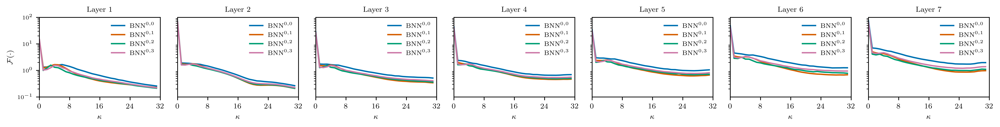

In [43]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np

# Define colorblind-friendly colors
colors = {
    'blue': '#0072B2',
    'orange': '#D55E00',
    'green': '#009E73',
    'red': '#CC79A7'
}

# Create a figure instance
fig = plt.figure(figsize=(15, 2), dpi=1200)
gs = gridspec.GridSpec(1, 7)  # 1 row, 7 columns


plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'

for layer_number in range(1, 8):
    j = (layer_number - 1)
    
    ax = plt.subplot(gs[0, layer_number - 1])
    ax.set_title(f'Layer {layer_number}', fontsize=8)
    
    label_string = r"$\mathrm{BNN}^{0,0}$"
    ax.plot(k, act_BNN_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['blue'])
    
    label_string = r"$\mathrm{BNN}^{0,1}$"
    ax.plot(k, act_inf_bnn_case3_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['orange'])
    
    label_string = r"$\mathrm{BNN}^{0,2}$"
    ax.plot(k, act_inf_bnn_case2_new_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['green'])
    
    label_string = r"$\mathrm{BNN}^{0,3}$"
    ax.plot(k, act_inf_bnn_case4_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['red'])
    
    ax.set_yscale('log')
    ax.legend(loc='best', frameon=False, fontsize=7)
    
    ax.set_xlabel(r"$\kappa$", fontsize=8)
    
    ax.set_xticks([0, 8, 16, 24, 32]) 
    ax.set_yticks([])
    
    ax.tick_params(axis='x', labelsize=8)  # Set x-ticks fontsize
    ax.tick_params(axis='y', labelsize=6)  # Set y-ticks fontsize
    
    ax.set_xlim(0, 32)
    ax.set_ylim(1e-1, 1e2)

    if layer_number == 1:
        ax.set_ylabel(r"$\mathcal{F}(\cdot)$", fontsize=8)
        ax.set_yticks([0.1, 1, 10, 100] )
        
    

plt.tight_layout()
plt.show()

#### Comparison of TLNN vs. BNN (Case1)

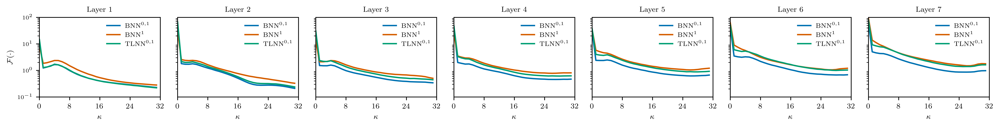

In [50]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np

# Define colorblind-friendly colors
colors = {
    'blue': '#0072B2',
    'orange': '#D55E00',
    'green': '#009E73',
    'red': '#CC79A7'
}

# Create a figure instance
fig = plt.figure(figsize=(15, 2), dpi=1200)
gs = gridspec.GridSpec(1, 7)  # 1 row, 7 columns


plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'

for layer_number in range(1, 8):
    j = (layer_number - 1)
    ax = plt.subplot(gs[0, layer_number - 1])
    ax.set_title(f'Layer {layer_number}', fontsize=8)
    
    label_string = r"$\mathrm{BNN}^{0,1}$"
    ax.plot(k, act_inf_bnn_case3_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['blue'])
    
    label_string = r"$\mathrm{BNN}^{1}$"
    ax.plot(k, act_Case3_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['orange'])
    
    label_string = r"$\mathrm{TLNN}^{0,1}$"
    ax.plot(k, act_bnn_case3_10p_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['green'])
    
    ax.set_yscale('log')
    ax.legend(loc='best', frameon=False, fontsize=7)
    
    ax.set_xlabel(r"$\kappa$", fontsize=8)
    
    ax.set_xticks([0, 8, 16, 24, 32]) 
    ax.set_yticks([])
    
    ax.tick_params(axis='x', labelsize=8)  # Set x-ticks fontsize
    ax.tick_params(axis='y', labelsize=6)  # Set y-ticks fontsize
    
    ax.set_xlim(0, 32)
    ax.set_ylim(1e-1, 1e2)

    if layer_number == 1:
        ax.set_ylabel(r"$\mathcal{F}(\cdot)$", fontsize=8)
        ax.set_yticks([0.1, 1, 10, 100] )
    

plt.tight_layout()
plt.show()

#### Comparison of TLNN vs. BNN (Case2)

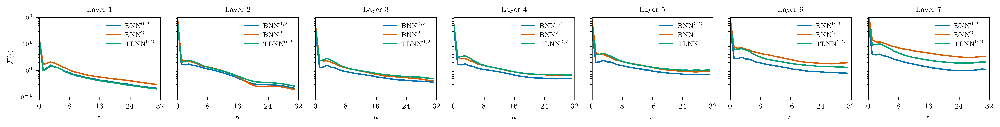

In [49]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np

# Define colorblind-friendly colors
colors = {
    'blue': '#0072B2',
    'orange': '#D55E00',
    'green': '#009E73',
    'red': '#CC79A7'
}

# Create a figure instance
fig = plt.figure(figsize=(15, 2), dpi=1200)
gs = gridspec.GridSpec(1, 7)  # 1 row, 7 columns


plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'

for layer_number in range(1, 8):
    j = (layer_number - 1)
    ax = plt.subplot(gs[0, layer_number - 1])
    ax.set_title(f'Layer {layer_number}', fontsize=8)
    
    label_string = r"$\mathrm{BNN}^{0,2}$"
    ax.plot(k, act_inf_bnn_case2_new_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['blue'])
    
    label_string = r"$\mathrm{BNN}^{2}$"
    ax.plot(k, act_Case2_with_better_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['orange'])
    
    label_string = r"$\mathrm{TLNN}^{0,2}$"
    ax.plot(k, act_bnn_case2_10p_new_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['green'])
    
    ax.set_yscale('log')
    ax.legend(loc='best', frameon=False, fontsize=7)
    
    ax.set_xlabel(r"$\kappa$", fontsize=8)
    
    ax.set_xticks([0, 8, 16, 24, 32]) 
    ax.set_yticks([])
    
    ax.tick_params(axis='x', labelsize=8)  # Set x-ticks fontsize
    ax.tick_params(axis='y', labelsize=6)  # Set y-ticks fontsize
    
    ax.set_xlim(0, 32)
    ax.set_ylim(1e-1, 1e2)

    if layer_number == 1:
        ax.set_ylabel(r"$\mathcal{F}(\cdot)$", fontsize=8)
        ax.set_yticks([0.1, 1, 10, 100] )
    

plt.tight_layout()
plt.show()

#### Comparison of TLNN vs. BNN (Case3)

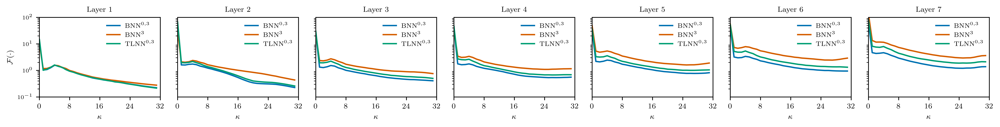

In [51]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np

# Define colorblind-friendly colors
colors = {
    'blue': '#0072B2',
    'orange': '#D55E00',
    'green': '#009E73',
    'red': '#CC79A7'
}

# Create a figure instance
fig = plt.figure(figsize=(15, 2), dpi=1200)
gs = gridspec.GridSpec(1, 7)  # 1 row, 7 columns


plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'

for layer_number in range(1, 8):
    j = (layer_number - 1)
    ax = plt.subplot(gs[0, layer_number - 1])
    ax.set_title(f'Layer {layer_number}', fontsize=8)
    
    label_string = r"$\mathrm{BNN}^{0,3}$"
    ax.plot(k, act_inf_bnn_case4_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['blue'])
    
    label_string = r"$\mathrm{BNN}^{3}$"
    ax.plot(k, act_Case4_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['orange'])
    
    label_string = r"$\mathrm{TLNN}^{0,3}$"
    ax.plot(k, act_bnn_case4_10p_spec_list[j].mean(axis=(0,1)).T, label=label_string, linestyle="solid", linewidth=1.5, color=colors['green'])
    
    ax.set_yscale('log')
    ax.legend(loc='best', frameon=False, fontsize=7)
    
    ax.set_xlabel(r"$\kappa$", fontsize=8)
    
    ax.set_xticks([0, 8, 16, 24, 32]) 
    ax.set_yticks([])
    
    ax.tick_params(axis='x', labelsize=8)  # Set x-ticks fontsize
    ax.tick_params(axis='y', labelsize=6)  # Set y-ticks fontsize
    
    ax.set_xlim(0, 32)
    ax.set_ylim(1e-1, 1e2)

    if layer_number == 1:
        ax.set_ylabel(r"$\mathcal{F}(\cdot)$", fontsize=8)
        ax.set_yticks([0.1, 1, 10, 100] )
    

plt.tight_layout()
plt.show()

#### Plot Output spectrum

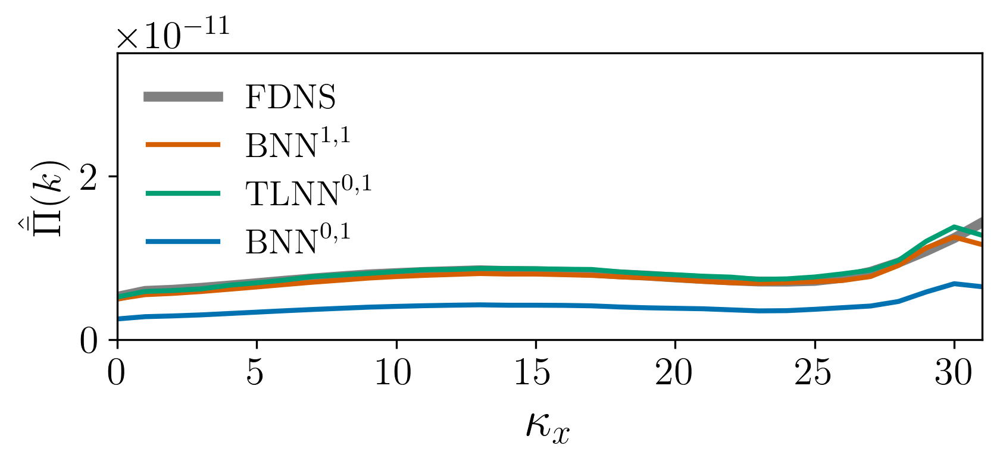

In [36]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming Case3 and bnn_case3_10p, inf_bnn_case3 are defined earlier in your code

colors = {
    'blue': '#0072B2',
    'orange': '#D55E00',
    'green': '#009E73',
    'red': '#CC79A7'
}

# Setting plot parameters
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 20
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16
plt.rcParams['axes.labelweight'] = 'bold'

# Create a figure instance
fig, ax = plt.subplots(figsize=(6, 3), dpi=300)

# Plotting the data
ax.plot(Case3.kt, (Case3.true_spec[:, 0].mean(axis=0).T), label=r'FDNS', color='gray', linewidth=4)
ax.plot(Case3.kt, (Case3.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{1,1}$', color=colors['orange'], linewidth=2)
ax.plot(bnn_case3_10p.km, (bnn_case3_10p.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{TLNN}^{0,1}$', color=colors['green'], linewidth=2)
ax.plot(inf_bnn_case3.km, (inf_bnn_case3.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{0,1}$', color=colors['blue'], linewidth=2)

# Setting x and y limits
ax.set_xlim(0, 31)
ax.set_ylim(0, 3.5e-11)
ax.set_xlabel('$\kappa_x$', fontsize=20)

# Setting y-axis label
ax.set_ylabel(r"$\hat{\bar{{\Pi}}}(k) $")

# Creating a legend at the bottom
legend_properties = {'weight': 'bold', 'size': 14}
ax.legend(loc='best', frameon=False, prop=legend_properties)

# Adjust layout
plt.tight_layout()
plt.show()

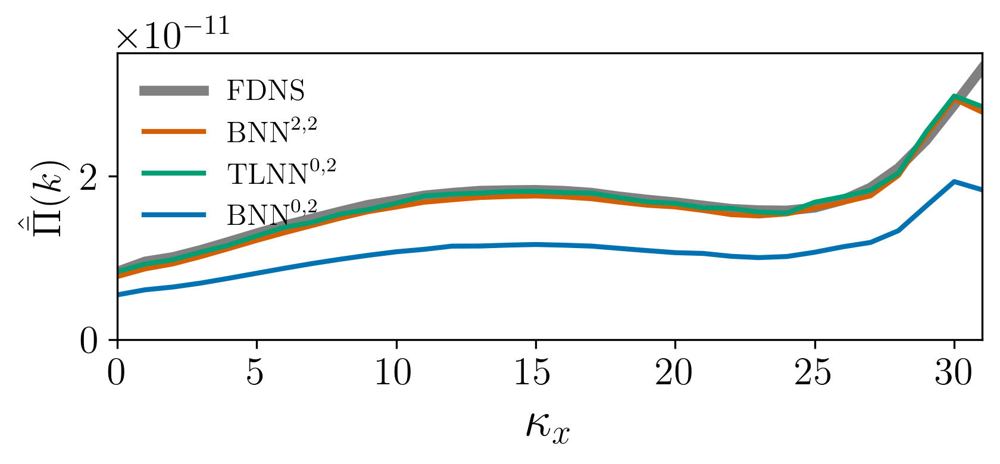

In [41]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming Case3 and bnn_case3_10p, inf_bnn_case3 are defined earlier in your code

colors = {
    'blue': '#0072B2',
    'orange': '#D55E00',
    'green': '#009E73',
    'red': '#CC79A7'
}

# Setting plot parameters
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 20
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16
plt.rcParams['axes.labelweight'] = 'bold'

# Create a figure instance
fig, ax = plt.subplots(figsize=(6, 3), dpi=300)

# Plotting the data
ax.plot(Case2_with_better.kt, (Case2_with_better.true_spec[:, 0].mean(axis=0).T), label=r'FDNS', color='gray', linewidth=4)
ax.plot(Case2_with_better.kt, (Case2_with_better.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{2,2}$', color=colors['orange'], linewidth=2)
ax.plot(bnn_case2_10p_new.km, (bnn_case2_10p_new.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{TLNN}^{0,2}$', color=colors['green'], linewidth=2)
ax.plot(inf_bnn_case2_new.km, (inf_bnn_case2_new.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{0,2}$', color=colors['blue'], linewidth=2)

# Setting x and y limits
ax.set_xlim(0, 31)
ax.set_ylim(0, 3.5e-11)
ax.set_xlabel('$\kappa_x$', fontsize=20)

# Setting y-axis label
ax.set_ylabel(r"$\hat{\bar{{\Pi}}}(k) $")

# Creating a legend at the bottom
legend_properties = {'weight': 'bold', 'size': 12}
ax.legend(loc='best', frameon=False, prop=legend_properties)

# Adjust layout
plt.tight_layout()
plt.show()

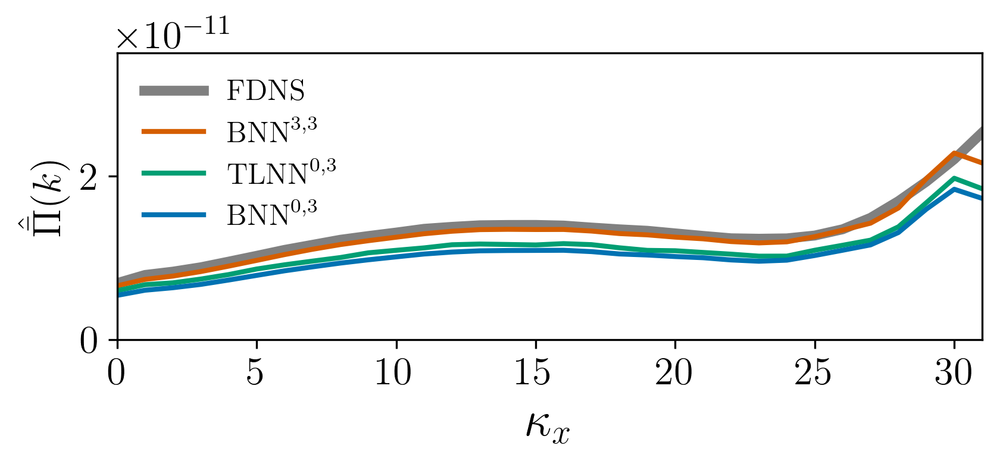

In [43]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming Case3 and bnn_case3_10p, inf_bnn_case3 are defined earlier in your code

colors = {
    'blue': '#0072B2',
    'orange': '#D55E00',
    'green': '#009E73',
    'red': '#CC79A7'
}

# Setting plot parameters
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 20
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16
plt.rcParams['axes.labelweight'] = 'bold'

# Create a figure instance
fig, ax = plt.subplots(figsize=(6, 3), dpi=300)

# Plotting the data
ax.plot(Case4.kt, (Case4.true_spec[:, 0].mean(axis=0).T), label=r'FDNS', color='gray', linewidth=4)
ax.plot(Case4.kt, (Case4.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{3,3}$', color=colors['orange'], linewidth=2)
ax.plot(bnn_case4_10p.km, (bnn_case4_10p.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{TLNN}^{0,3}$', color=colors['green'], linewidth=2)
ax.plot(inf_bnn_case4.km, (inf_bnn_case4.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{0,3}$', color=colors['blue'], linewidth=2)

# Setting x and y limits
ax.set_xlim(0, 31)
ax.set_ylim(0, 3.5e-11)
ax.set_xlabel('$\kappa_x$', fontsize=20)

# Setting y-axis label
ax.set_ylabel(r"$\hat{\bar{{\Pi}}}(k) $")

# Creating a legend at the bottom
legend_properties = {'weight': 'bold', 'size': 12}
ax.legend(loc='best', frameon=False, prop=legend_properties)

# Adjust layout
plt.tight_layout()
plt.show()

In [44]:
Case3.input_spec.shape

torch.Size([2166, 4, 32])

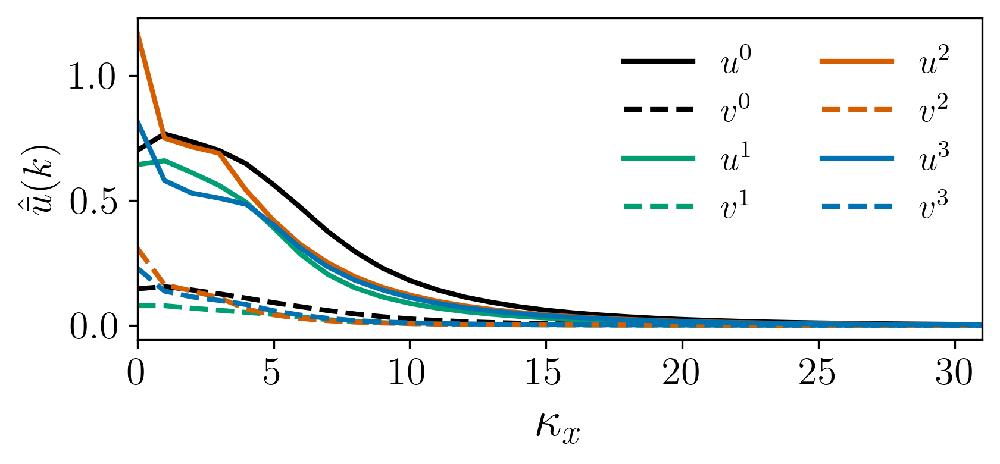

In [64]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming Case3 and bnn_case3_10p, inf_bnn_case3 are defined earlier in your code

colors = {
    'blue': '#0072B2',
    'orange': '#D55E00',
    'green': '#009E73',
    'red': '#CC79A7'
}

# Setting plot parameters
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 20
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16
plt.rcParams['axes.labelweight'] = 'bold'

# Create a figure instance
fig, ax = plt.subplots(figsize=(6, 3), dpi=300)

# Plotting the data
ax.plot(BNN.kt, (BNN.input_spec[:, 0].mean(axis=0).T), label=r'$u^{0}$', color='black', linewidth=2)
ax.plot(BNN.kt, (BNN.input_spec[:, 1].mean(axis=0).T), label=r'$v^{0}$', color='black', linewidth=2, linestyle='dashed')

ax.plot(Case3.kt, (Case3.input_spec[:, 0].mean(axis=0).T), label=r'$u^{1}$', color=colors['green'], linewidth=2)
ax.plot(Case3.kt, (Case3.input_spec[:, 1].mean(axis=0).T), label=r'$v^{1}$', color=colors['green'], linewidth=2, linestyle='dashed')

ax.plot(Case2_with_better.kt, (Case2_with_better.input_spec[:, 0].mean(axis=0).T), label=r'$u^{2}$', color=colors['orange'], linewidth=2)
ax.plot(Case2_with_better.kt, (Case2_with_better.input_spec[:, 1].mean(axis=0).T), label=r'$v^{2}$', color=colors['orange'], linewidth=2, linestyle='dashed')

ax.plot(Case4.kt, (Case4.input_spec[:, 0].mean(axis=0).T), label=r'$u^{3}$', color=colors['blue'], linewidth=2)
ax.plot(Case4.kt, (Case4.input_spec[:, 1].mean(axis=0).T), label=r'$v^{3}$', color=colors['blue'], linewidth=2, linestyle='dashed')

# ax.plot(Case3.kt, (Case3.input_spec[:, 2].mean(axis=0).T), label=r'$v^{1}_{3}$', color=colors['green'], linewidth=2)
# ax.plot(Case3.kt, (Case3.input_spec[:, 3].mean(axis=0).T), label=r'$v^{1}_{4}$', color=colors['blue'], linewidth=2)

# ax.plot(Case2_with_better.kt, (Case2_with_better.true_spec[:, 0].mean(axis=0).T), label=r'FDNS', color='gray', linewidth=4)
# ax.plot(Case2_with_better.kt, (Case2_with_better.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{2,2}$', color=colors['orange'], linewidth=2)
# ax.plot(Case4.kt, (Case4.true_spec[:, 0].mean(axis=0).T), label=r'FDNS', color='gray', linewidth=4)
# ax.plot(Case4.kt, (Case4.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{3,3}$', color=colors['orange'], linewidth=2)
# ax.plot(bnn_case4_10p.km, (bnn_case4_10p.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{TLNN}^{0,3}$', color=colors['green'], linewidth=2)
# ax.plot(inf_bnn_case4.km, (inf_bnn_case4.model_spec[:, 0].mean(axis=0).T), label=r'$\mathrm{BNN}^{0,3}$', color=colors['blue'], linewidth=2)

# Setting x and y limits
ax.set_xlim(0, 31)
# ax.set_ylim(0, 3.5e-11)
ax.set_xlabel('$\kappa_x$', fontsize=20)

# Setting y-axis label
ax.set_ylabel(r"$\hat{\bar{{u}}}(k) $")

# Creating a legend at the bottom
legend_properties = {'weight': 'bold', 'size': 14}
ax.legend(loc='best', frameon=False, prop=legend_properties, ncol=2)

# Adjust layout
plt.tight_layout()
plt.show()

# Plotting Online runs

## Setup to get the online figures


### Importing libs

In [2]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

import pyqg
from pyqg import diagnostic_tools as tools


import pyfftw

### Setting cases parameters

In [8]:
year = 24*60*60*360.
day = 24*60*60.
hr = 60*60.

base_kwargs = dict(tmax=10*year, dt=1*hr, twrite=10000, tavestart=0, taveint=1*day)


bnn = { "beta": 1.5e-11, #[m^-1 s^-1]
       "delta": 0.25,
       "rek": 5.78e-7, #[s^-1]
       "rd": 15e3, # [m]
}
case2 = { "beta": 5e-12,
            "delta": 0.05,
            "rek": 3.5e-8,
            "rd": 15e3,
}
case3 = { "beta": 1.5e-11,
            "delta": 0.25,
            "rek": 5.78e-7,
            "rd": 20e3,
}
case4 = { "beta": 1e-11,
       "delta": 0.1,
       "rek": 7e-8, #[s^-1]
       "rd": 15e3,
}

In [ ]:
bnn_lowres = pyqg.QGModel(nx = 64, **base_kwargs, **bnn)
case2_lowres = pyqg.QGModel(nx = 64, **base_kwargs, **case2)
case3_lowres = pyqg.QGModel(nx = 64, **base_kwargs, **case3)
case4_lowres = pyqg.QGModel(nx = 64, **base_kwargs, **case4)

bnn_highres = pyqg.QGModel(nx = 256, **base_kwargs, **bnn)
case2_highres = pyqg.QGModel(nx = 256, **base_kwargs, **case2)
case3_highres = pyqg.QGModel(nx = 256, **base_kwargs, **case3)
case4_highres = pyqg.QGModel(nx = 256, **base_kwargs, **case4)


### Defninig functions for metrics

In [10]:
import numpy as np
from sklearn.neighbors import KernelDensity

def PDF_histogram(x, xmin=None, xmax=None, Nbins=100):
    """
    x is 1D numpy array with data
    How to use:
        first apply without arguments
        Then adjust xmin, xmax, Nbins
    """    
    N = x.shape[0]

    mean = x.mean()
    sigma = x.std()
    
    if xmin is None:
        xmin = mean-4*sigma
    if xmax is None:
        xmax = mean+4*sigma

    bandwidth = (xmax - xmin) / Nbins
    
    hist, bin_edges = np.histogram(x, range=(xmin,xmax), bins = Nbins)

    # hist / N is probability to go into bin
    # probability / bandwidth = probability density
    # density = hist / N / bandwidth
    density = hist / N 

    # we assign one value to each bin
    points = (bin_edges[0:-1] + bin_edges[1:]) * 0.5

    #print(f"Number of bins = {Nbins}, over the interval ({xmin},{xmax}), with bandwidth = {bandwidth}")
    #print(f"This interval covers {sum(hist)/N} of total probability")
    
    return points/sigma, density



def PDF_var_for_ross_data(ds, var, lev):
        # ds_ = ds.isel(lev=lev, time=slice(-30,None)).mean('run')
        ds_ = ds.isel(lev=lev, time=slice(-10,None)).stack(new_dim=['time', 'run'])
        if var == 'KE':
            values = KE(ds_)
        elif var == 'Ens':
            values = Ens(ds_)
        else:
            values = ds_[var]
        values = values.values.ravel()

        xmin = 0 if var in ['KE', 'Ens'] else None
        if var=='Ens' and lev==0:
            xmax = 1e-10
        elif var=='Ens' and lev==1:
            xmax = 1.5e-12
        elif var=='KE' and lev==0:
            xmax = 1.5e-2
        elif var=='KE' and lev==1:
            xmax = 5e-4
        else:
            xmax = None

        points, density = PDF_kdensity(values, xmin=xmin, xmax=xmax)
        return xr.DataArray(density, dims=f'{var}_{lev}', coords=[points])


def PDF_var_test(ds, var, lev):
    
    # time = slice(-1, None)
    ds_ = ds.isel(lev=lev, time=slice(-360*5,None)).stack(new_dim=['time', 'run'])
    if var == 'KE':
        values = KE(ds_)
    elif var == 'Ens':
        values = Ens(ds_)
    else:
        values = ds_[var]
    values = values.values.ravel()

    xmin = 0 if var in ['KE', 'Ens'] else None
    if var=='Ens' and lev==0:
        xmax = 1e-10
    elif var=='Ens' and lev==1:
        xmax = 1.5e-12
    elif var=='KE' and lev==0:
        xmax = 1.5e-2
    elif var=='KE' and lev==1:
        xmax = 5e-4
    else:
        xmax = None

    points, density = PDF_histogram(values, xmin=xmin, xmax=xmax)
    return xr.DataArray(density, dims=f'{var}_{lev}', coords=[points])

def PDF_var_for_ross_data_test(ds, var, lev):
        # ds_ = ds.isel(lev=lev, time=slice(-30,None)).mean('run')
        ds_ = ds.isel(lev=lev, time=slice(-10,None)).stack(new_dim=['time', 'run'])
        if var == 'KE':
            values = KE(ds_)
        elif var == 'Ens':
            values = Ens(ds_)
        else:
            values = ds_[var]
        values = values.values.ravel()

        xmin = 0 if var in ['KE', 'Ens'] else None
        if var=='Ens' and lev==0:
            xmax = 1e-10
        elif var=='Ens' and lev==1:
            xmax = 1.5e-12
        elif var=='KE' and lev==0:
            xmax = 1.5e-2
        elif var=='KE' and lev==1:
            xmax = 5e-4
        else:
            xmax = None

        points, density = PDF_histogram(values, xmin=xmin, xmax=xmax)
        return xr.DataArray(density, dims=f'{var}_{lev}', coords=[points])

In [5]:
import numpy as np
import xarray as xr
import pyqg

coord = lambda x, name: xr.DataArray(x, attrs={'long_name': name})

class spectrum():
    def __init__(self, type='power', averaging=False, truncate=False, time=slice(-5,-1)):
        '''
        Init type of transform here
        Usage to compute power spectrum:
        spectrum()(q)
        '''
        self.type = type
        self.averaging = averaging
        self.truncate = truncate
        self.time = time

    def test(self, sp, *x):
        def sel(_x):
            __x = _x.isel(time=self.time)
            return __x - __x.mean(dim=('x','y'))

        k = sp.k; dk = k[1] - k[0]
        Esp = sp.sum() * dk
        if self.type == 'power':
            E = sel(x[0])**2
        elif self.type == 'energy':
            E = 0.5*sel(x[0])**2
        elif self.type == 'cospectrum':
            E = sel(x[0]) * sel(x[1])
        elif self.type == 'cross_layer':
            _x = sel(x[0])
            E = _x[:,:,0] * _x[:,:,1]

        E = E.mean(dim=('run','time','x','y'))
        try:
            E = E.sum(dim='lev')
        except:
            pass

        rel_error = float(np.abs((Esp-E)/E))
        #print(f'Relative error in spectral sum for {self.type}: {rel_error}')

    def fft2d(self, _xarray):
        M = _xarray.shape[-1] * _xarray.shape[-2]
        x = _xarray.isel(time=self.time).values.astype('float64')
        return np.fft.rfftn(x, axes=(-2,-1)) / M

    def isotropize(self, af2, *x, name, description, units):
        m = pyqg.QGModel(nx=len(x[0].x), log_level=0)
        if self.type != 'cross_layer':
            sp_list = []
            for z in [0,1]:
                k, sp = calc_ispec(m, af2[z,:,:], averaging=self.averaging, truncate=self.truncate)
                sp_list.append(sp) # as power spectral density

            sp = xr.DataArray(np.stack(sp_list, axis=0), dims=['lev', 'k'], coords=[m.to_dataset().lev, coord(k, 'isotropic wavenumber, $m^{-1}$')],attrs={'long_name': name, 'description': description, 'units': units})
        elif self.type == 'cross_layer':
            k, sp = calc_ispec(m, af2[:,:], averaging=self.averaging, 
                truncate=self.truncate)
            
            sp = xr.DataArray(sp, dims=['k'], 
                coords=[coord(k, 'isotropic wavenumber, $m^{-1}$')],
                attrs={'long_name': name, 'description': description, 'units': units})
        return sp
    
    def __call__(self, *_x, name='', description='', units=''):
        '''
        *x - list of xarray tensors,
        nrun x ntime x nlev x Ny x Nx
        '''
        x = []
        for xx in _x:
            if 'run' not in xx.dims:
                xx = xx.expand_dims('run')
            if 'time' not in xx.dims:
                xx = xx.expand_dims('time')
                self.time=slice(0,1)
            x.append(xx)

        if self.type == 'power':
            af2 = np.abs(self.fft2d(x[0]))**2
        elif self.type == 'energy':
            af2 = np.abs(self.fft2d(x[0]))**2 / 2
        elif self.type == 'cospectrum':
            af2 = np.real(np.conj(self.fft2d(x[0])) * self.fft2d(x[1]))
        elif self.type == 'cross_layer':
            xf = self.fft2d(x[0])
            af2 = np.real(np.conj(xf[:,:,0]) * xf[:,:,1])
        
        af2 = af2.mean(axis=(0,1))

        sp = self.isotropize(af2, *x, name=name, description=description, units=units)

        #self.test(sp, *x)

        return sp

def calc_ispec(model, _var_dens, averaging = True, truncate=True, nd_wavenumber=False, nfactor = 1):
    """Compute isotropic spectrum `phr` from 2D spectrum of variable signal2d.

    Parameters
    ----------
    model : pyqg.Model instance
        The model object from which `var_dens` originates
    
    var_dens : squared modulus of fourier coefficients like this:
        np.abs(signal2d_fft)**2/m.M**2

    averaging: If True, spectral density is estimated with averaging over circles,
        otherwise summation is used and Parseval identity holds

    truncate: If True, maximum wavenumber corresponds to inner circle in Fourier space,
        otherwise - outer circle
    
    nd_wavenumber: If True, wavenumber is nondimensional: 
        minimum wavenumber is 1 and corresponds to domain length/width,
        otherwise - wavenumber is dimensional [m^-1]

    nfactor: width of the bin in sqrt(dk^2+dl^2) units

    Returns
    -------
    kr : array
        isotropic wavenumber
    phr : array
        isotropic spectrum

    Normalization:
    signal2d.var() = phr.sum() * (kr[1] - kr[0])
    """

    # account for complex conjugate
    var_dens = np.copy(_var_dens)
    var_dens[...,0] /= 2
    var_dens[...,-1] /= 2

    ll_max = np.abs(model.ll).max()
    kk_max = np.abs(model.kk).max()

    if truncate:
        kmax = np.minimum(ll_max, kk_max)
    else:
        kmax = np.sqrt(ll_max**2 + kk_max**2)
    
    kmin = np.minimum(model.dk, model.dl)

    dkr = np.sqrt(model.dk**2 + model.dl**2) * nfactor

    # left border of bins
    kr = np.arange(kmin, kmax-dkr, dkr)
    
    phr = np.zeros(kr.size)

    for i in range(kr.size):
        if averaging:
            fkr =  (model.wv>=kr[i]) & (model.wv<=kr[i]+dkr)    
            if fkr.sum() == 0:
                phr[i] = 0.
            else:
                phr[i] = var_dens[fkr].mean() * (kr[i]+dkr/2) * np.pi / (model.dk * model.dl)
        else:
            fkr =  (model.wv>=kr[i]) & (model.wv<kr[i]+dkr)
            phr[i] = var_dens[fkr].sum() / dkr
        
        phr[i] *= 2
    
    # convert left border of the bin to center
    kr = kr + dkr/2

    # convert to non-dimensional wavenumber 
    # preserving integral over spectrum
    if nd_wavenumber:
        kr = kr / kmin
        phr = phr * kmin

    return kr, phr


import xarray as xr
def ave_lev(arr: xr.DataArray, delta):
    '''
    Average over depth xarray
    delta = H1/H2
    H = H1+H2
    Weights are:
    Hi[0] = H1/H = H1/(H1+H2)=H1/H2/(H1/H2+1)=delta/(1+delta)
    Hi[1] = H2/H = H2/(H1+H2)=1/(1+delta)
    '''
    if 'lev' in arr.dims:
        Hi = xr.DataArray([delta/(1+delta), 1/(1+delta)], dims=['lev'])
        out  = (arr*Hi).sum(dim='lev')
        out.attrs = arr.attrs
        return out
    else:
        return arr

def KE(ds):
        return (ds.u**2 + ds.v**2) * 0.5


def Ens(ds):
        return 0.5 * (relative_vorticity(ds))**2

def KE_time(ds):
        delta=0.1
        return ave_lev(KE(ds), delta=delta).mean(('run', 'x', 'y'))
        # return ave_lev(KE(ds), delta=delta).mean(( 'x', 'y'))
    

## Spectrums

### Case 1 (TKE spectrum)

In [18]:
# DO all above for Case 3
# ke_spec_3_accu = 0
# leng = 100
# for i in range(leng):
#     ke_spec_3 = xr.open_dataset(f'/ocean/projects/atm170004p/shared/for_ashesh/eddy_radius-20000/{i}.nc')['KEspec'].isel(lev=0)

#     ke_spec_3_accu += ke_spec_3

# ke_spec_3_accu /= leng    

# kr_case3_fdns, case3_spec_fdns = calc_ispec(case3_lowres, ke_spec_3_accu)

case3_fdns = xr.open_dataset('/media/volume/sdc/ross_data/eddy_radius-20000/99.nc')
case3_lores = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case3_lores_comb.nc')
case3_bnn = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case3_bnn_comb.nc')
case3_cnn = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case3_cnn_comb.nc')
case3_tl2p = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case3_tl2p_comb.nc')
case3_tl10p = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case3_tl10p_comb.nc')

kr_case3_fdns, case3_spec_fdns = calc_ispec(case3_lowres, case3_fdns['KEspec'].isel(lev=0))
kr_case3_lores, case3_spec_lores = calc_ispec(case3_lowres, case3_lores['KEspec'].isel(lev=0).mean(( 'run')))
kr_case3_bnn, case3_spec_bnn = calc_ispec(case3_lowres, case3_bnn['KEspec'].isel(lev=0).mean(( 'run')))
kr_case3_cnn, case3_spec_cnn = calc_ispec(case3_lowres, case3_cnn['KEspec'].isel(lev=0).mean(( 'run')))
kr_case3_tl2p, case3_spec_tl2p = calc_ispec(case3_lowres, case3_tl10p['KEspec'].isel(lev=0).mean(( 'run')))
kr_case3_tl10sp, case3_spec_tl10p = calc_ispec(case3_lowres, case3_tl10p['KEspec'].isel(lev=0).mean(( 'run')))

plt.figure(figsize=(15, 5), dpi=1200)

plt.rcParams.update({'font.size': 24})

plt.rc('text', usetex=True)

plt.loglog(kr_case3_fdns, case3_spec_fdns, label='FDNS', color='black', linestyle='solid', linewidth=3)
plt.loglog(kr_case3_lores, case3_spec_lores, label=r'NoSGS $(N_x=64)$', color='gray', linewidth=3)
plt.loglog(kr_case3_bnn, case3_spec_bnn, label=r'$\mathrm{BNN}^{0,1}$', color='red', linestyle='dashed', linewidth=2)

plt.loglog(kr_case3_tl2p, case3_spec_tl2p, label=r'$\mathrm{TLNN}^{0,1}_{2\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=0.5)
plt.loglog(kr_case3_tl10sp, case3_spec_tl10p, label=r'$\mathrm{TLNN}^{0,1}_{10\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=1)

# plt.loglog(kr_case3_cnn, case3_spec_cnn, label='CNN', color='green', linestyle='dashed', linewidth=2)

plt.title("Case 1: KE Spectra", fontsize=24)
plt.ylabel(r'KE Spectra $(m^3/s^2)$')
plt.xlabel(r'$\kappa_x (m^{-1})$')
plt.grid(True, which="both", ls="-")
plt.legend(frameon=False, fontsize=24)
plt.ylim(1e-4, 2e2)

(0.0001, 200.0)

### Case2 (TKE spectrum)

(0.01, 200.0)

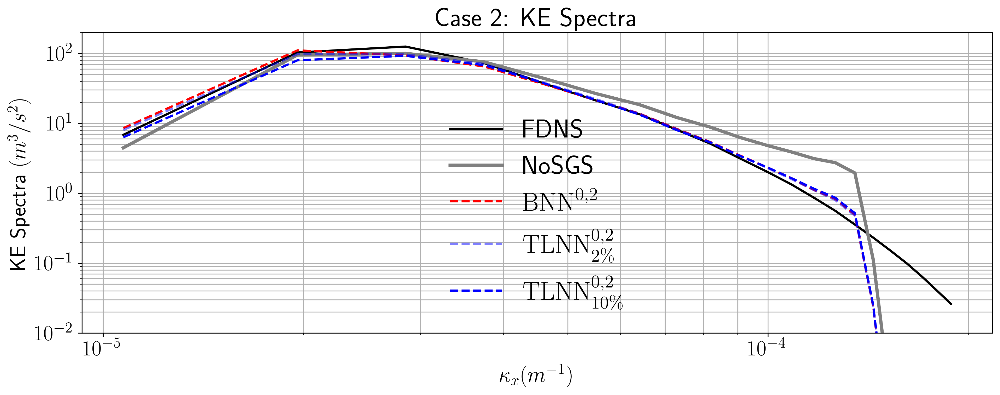

In [19]:
# Do all above for Case 2
ke_spec_2_accu = 0
leng = 78
for i in range(leng):
    ke_spec_2 = xr.open_dataset(f'/media/volume/sdc/ross_data/3jet/{i}.nc')['KEspec'].isel(lev=0)

    ke_spec_2_accu += ke_spec_2

ke_spec_2_accu /= leng    

kr_case2_fdns, case2_spec_fdns = calc_ispec(case2_lowres, ke_spec_2_accu)
case2_lores = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case2_lores_comb.nc')
case2_bnn = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case2_bnn_comb.nc')
case2_cnn = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case2_cnn_comb.nc')
case2_tl2p = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case2_tl2p_comb.nc')
case2_tl10p = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case2_tl10p_comb.nc')



kr_case2_lores, case2_spec_lores = calc_ispec(case2_lowres, case2_lores['KEspec'].isel(lev=0).mean(( 'run')))
kr_case2_bnn, case2_spec_bnn = calc_ispec(case2_lowres, case2_bnn['KEspec'].isel(lev=0).mean(( 'run')))
kr_case2_cnn, case2_spec_cnn = calc_ispec(case2_lowres, case2_cnn['KEspec'].isel(lev=0).mean(( 'run')))
kr_case2_tl2p, case2_spec_tl2p = calc_ispec(case2_lowres, case2_tl2p['KEspec'].isel(lev=0).mean(( 'run')))
kr_case2_tl10p, case2_spec_tl10p = calc_ispec(case2_lowres, case2_tl10p['KEspec'].isel(lev=0).mean(( 'run')))

plt.figure(figsize=(15, 5), dpi=300)
plt.rcParams.update({'font.size': 20})
plt.rc('text', usetex=True)

plt.loglog(kr_case2_fdns, case2_spec_fdns, label='FDNS', color='black', linestyle='solid', linewidth=2)
plt.loglog(kr_case2_lores, case2_spec_lores, label=r'NoSGS', color='gray', linewidth=3)
# plt.loglog(kr_case2_cnn, case2_spec_cnn, label='CNN', color=r'$BNN^{2}$', linestyle='dashed', linewidth=2)

plt.loglog(kr_case2_bnn, case2_spec_bnn, label=r'$\mathrm{BNN}^{0,2}$', color='red', linestyle='dashed', linewidth=2)
plt.loglog(kr_case2_tl2p, case2_spec_tl2p, label=r'$\mathrm{TLNN}^{0,2}_{2\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=0.5)
plt.loglog(kr_case2_tl10p, case2_spec_tl10p, label=r'$\mathrm{TLNN}^{0,2}_{10\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=1)

plt.title('Case 2: KE Spectra', fontsize=24)
plt.ylabel(r'KE Spectra $(m^3/s^2)$')
plt.xlabel(r'$\kappa_x (m^{-1})$')
plt.grid(True, which="both", ls="-")
plt.legend(frameon=False, fontsize=24, loc='best')
plt.ylim(1e-2, 2e2)

### Case 3 (TKE Spectrum)

In [22]:
case4_forcing1 = xr.open_zarr('/media/volume/sdc/ross_data/publication/jet/forcing1.zarr')
case4_forcing2  = xr.open_zarr('/media/volume/sdc/ross_data/publication/jet/forcing2.zarr')
case4_forcing3  = xr.open_zarr('/media/volume/sdc/ross_data/publication/jet/forcing3.zarr')
case4_high_res  = xr.open_zarr('/media/volume/sdc/ross_data/publication/jet/high_res.zarr')
case4_low_res = xr.open_zarr('/media/volume/sdc/ross_data/publication/jet/low_res.zarr')

case4_lores = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case4_lores_comb.nc')
case4_bnn = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case4_bnn_comb.nc')
case4_cnn = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case4_cnn_comb.nc')
# case4_tl1sp = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case4_tl1sp_comb.nc')
case4_tl2p = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case4_tl2p_comb.nc')
case4_tl10p = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/Case4_tl10p_comb.nc')


kr_case4_highres, case4_spec_highres = calc_ispec(case4_highres, case4_high_res['KEspec'].isel(lev=0).mean(( 'run')))
kr_case4_lowres, case4_spec_lowres = calc_ispec(case4_lowres, case4_low_res['KEspec'].isel(lev=0).mean(( 'run')))
kr_case4_forcing1, case4_spec_forcing1 = calc_ispec(case4_lowres, case4_forcing1['KEspec'].isel(lev=0).mean(( 'run')))
kr_case4_forcing2, case4_spec_forcing2 = calc_ispec(case4_lowres, case4_forcing2['KEspec'].isel(lev=0).mean(( 'run')))
kr_case4_forcing3, case4_spec_forcing3 = calc_ispec(case4_lowres, case4_forcing3['KEspec'].isel(lev=0).mean(( 'run')))

kr_case4_lores, case4_spec_lores = calc_ispec(case4_lowres, case4_lores['KEspec'].isel(lev=0).mean(( 'run')))
kr_case4_bnn, case4_spec_bnn = calc_ispec(case4_lowres, case4_bnn['KEspec'].isel(lev=0).mean(( 'run')))
kr_case4_cnn, case4_spec_cnn = calc_ispec(case4_lowres, case4_cnn['KEspec'].isel(lev=0).mean(( 'run')))
kr_case4_tl2p, case4_spec_tl2p = calc_ispec(case4_lowres, case4_tl2p['KEspec'].isel(lev=0).mean(( 'run')))
kr_case4_tl10p, case4_spec_tl10p = calc_ispec(case4_lowres, case4_tl10p['KEspec'].isel(lev=0).mean(( 'run')))


# plt.loglog(kr_case4_highres, case4_spec_highres, label=r'HighRes $(N_x=256)$', color='black', linewidth=3)
# plt.loglog(kr_case4_lowres, case4_spec_lowres, label=r'NoSGS $(N_x=64)$', color='gray', linewidth=3)
# plt.loglog(kr_case4_forcing1, case4_spec_forcing1, label='FDNS (Spectral Filter)', color='red', linestyle='solid', linewidth=2)
# plt.loglog(kr_case4_forcing2, case4_spec_forcing2, label='FDNS (Gaussian Filter)', color='black', linestyle='solid', linewidth=3)
# plt.loglog(kr_case4_forcing3, case4_spec_forcing3, label='FDNS (Gaussian Filter)', color='green', linestyle='solid', linewidth=2)
# plt.loglog(kr_case4_lores, case4_spec_lores, label=r'NoSGS $(N_x=64)', color='red', linestyle='dashed', linewidth=2)
# plt.loglog(kr_case4_cnn, case4_spec_cnn, label='CNN', color='blue', linestyle='dashed', linewidth=2)

plt.figure(figsize=(15, 5), dpi=1200)
plt.rcParams.update({'font.size': 12})
plt.rc('text', usetex=True)
plt.loglog(kr_case4_forcing2, case4_spec_forcing2, label='$\mathrm{FDNS}$', color='black', linestyle='solid', linewidth=3)
plt.loglog(kr_case4_lowres, case4_spec_lowres, label=r'NoSGS', color='gray', linewidth=3)
plt.loglog(kr_case4_bnn, case4_spec_bnn, label=r'$\mathrm{BNN}^{0,3}$', color='red', linestyle='dashed', linewidth=2)

plt.loglog(kr_case4_tl2p, case4_spec_tl2p, label=r'$\mathrm{TLNN}^{0,3}_{2\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=0.5)
plt.loglog(kr_case4_tl10p, case4_spec_tl10p, label=r'$\mathrm{TLNN}^{0,3}_{10\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=1)

plt.title('Case 3, KE Spectra', fontsize=24)
plt.ylabel(r'KE Spectra $(m^3/s^2)$')
plt.xlabel(r'$\kappa_x (m^{-1})$')
plt.grid(True, which="both", ls="-")
plt.legend(frameon=False, fontsize=24, loc='best')
plt.ylim(1e-2, 1e2)


(0.01, 100.0)

## PDFs

### Case 1 (q PDF)

#### Calculation and saving

In [71]:
q_fdns_comb_case3 = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/q_fdns_comb_case3.nc')
pdf_q0_case3_fdns = PDF_var_test(q_fdns_comb_case3,'q', 0)
pdf_q0_case3_lores = PDF_var_test(case3_lores, 'q', 0)
pdf_q0_case3_bnn = PDF_var_test(case3_bnn, 'q', 0)
pdf_q0_case3_cnn = PDF_var_test(case3_cnn, 'q', 0)
pdf_q0_case3_tl2p = PDF_var_test(case3_tl2p, 'q', 0)
pdf_q0_case3_tl10p = PDF_var_test(case3_tl10p, 'q', 0)


#### Loading


#### Plotting

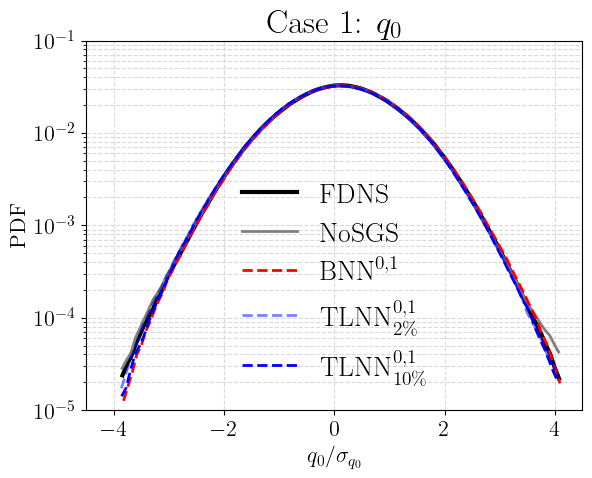

In [135]:
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 16
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16

plt.rcParams['axes.labelweight'] = 'bold'

# plt.plot(pdf_q0_case3_hires.coords['q_0'].values, pdf_q0_case3_hires, label='High Resolution', color='black', linewidth=3)

# plt.plot(pdf_q0_case3_cnn.coords['q_0'].values, pdf_q0_case3_cnn, label=r'$BNN^{1}$', color='black', linewidth=2, linestyle='dashed')

plt.plot(pdf_q0_case3_fdns.coords['q_0'].values, pdf_q0_case3_fdns, label='FDNS', color='black', linewidth=3,linestyle='solid')
plt.plot(pdf_q0_case3_lores.coords['q_0'].values, pdf_q0_case3_lores, label='NoSGS', color='gray', linewidth=2)
plt.plot(pdf_q0_case3_bnn.coords['q_0'].values, pdf_q0_case3_bnn, label=r'$\mathrm{BNN}^{0,1}$', color='red', linestyle='dashed', linewidth=2)
plt.plot(pdf_q0_case3_tl2p.coords['q_0'].values, pdf_q0_case3_tl2p, label=r'$\mathrm{TLNN}^{0,1}_{2\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=0.5)
plt.plot(pdf_q0_case3_tl10p.coords['q_0'].values, pdf_q0_case3_tl10p, label=r'$\mathrm{TLNN}^{0,1}_{10\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=1)


plt.grid(True, which="both", ls="--", color='0.85')
plt.title(r'Case 1: $q_0$', fontsize=24)
plt.yscale('log')
plt.xlabel(r'$q_0/\sigma_{q_0}$')
plt.ylabel(r'PDF')
plt.xlim(-4.5, 4.5)
plt.ylim(1e-5, 1e-1)
plt.legend(frameon=False, fontsize=20)
plt.show()

### Case2 (q PDF)

In [90]:
q_fdns_comb_case2 = xr.open_dataset('/media/volume/sdc/qg/TransferLearning-QG/online_results_for_Figures/q_fdns_comb_case2.nc')
pdf_q0_case2_fdns = PDF_var_test(q_fdns_comb_case2, 'q', 0)

pdf_q0_case2_lores = PDF_var_test(case2_lores, 'q', 0)
pdf_q0_case2_bnn = PDF_var_test(case2_bnn, 'q', 0)
pdf_q0_case2_cnn = PDF_var_test(case2_cnn, 'q', 0)

pdf_q0_case2_tl2p = PDF_var_test(case2_tl2p, 'q', 0)
pdf_q0_case2_tl10p = PDF_var_test(case2_tl10p, 'q', 0)


#### Loading


#### Plotting

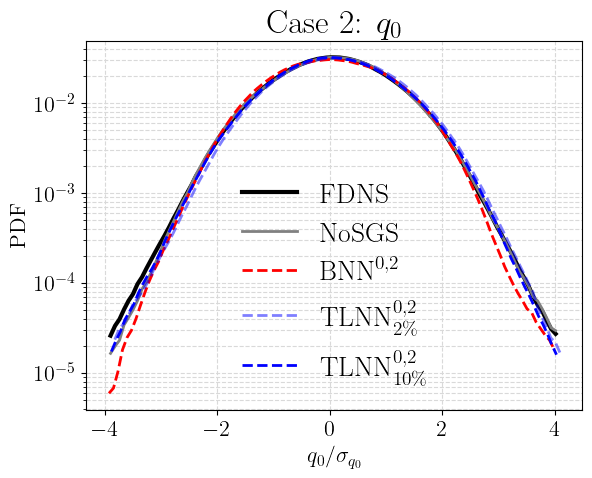

In [134]:
# plt.plot(pdf_q0_case2_hires.coords['q_0'].values, pdf_q0_case2_hires, label='High Resolution', color='black', linewidth=3)
# plt.plot(pdf_q0_case2_cnn.coords['q_0'].values, pdf_q0_case2_cnn, label=r'$BNN^{2}$', color='black', linewidth=2, linestyle='dashed')

plt.plot(pdf_q0_case2_fdns.coords['q_0'].values, pdf_q0_case2_fdns, label='FDNS', color='black', linewidth=3,linestyle='solid')
plt.plot(pdf_q0_case2_lores.coords['q_0'].values, pdf_q0_case2_lores, label='NoSGS', color='gray', linewidth=2)
plt.plot(pdf_q0_case2_bnn.coords['q_0'].values, pdf_q0_case2_bnn, label=r'$\mathrm{BNN}^{0,2}$', color='red', linestyle='dashed', linewidth=2)
plt.plot(pdf_q0_case2_tl2p.coords['q_0'].values, pdf_q0_case2_tl2p, label=r'$\mathrm{TLNN}^{0,2}_{2\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=0.5)
plt.plot(pdf_q0_case2_tl10p.coords['q_0'].values, pdf_q0_case2_tl10p, label=r'$\mathrm{TLNN}^{0,2}_{10\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=1)


plt.grid(True, which="both", ls="--", color='0.85')
plt.title('Case 2: $q_0$', fontsize=24)
plt.yscale('log')
plt.xlabel(r'$q_0/\sigma_{q_0}$')
plt.ylabel(r'PDF')
# plt.xlim(-4, 4)
# plt.ylim(1e2, 1e5)
plt.legend(frameon=False, fontsize=20)
plt.show()

### Case 3 (q PDF)

In [94]:
var = 'q'
pdf_q0_case4_hires = PDF_var_for_ross_data_test(case4_high_res, var, 0)
pdf_q0_case4_fdns = PDF_var_for_ross_data_test(case4_forcing2, var, 0)

pdf_q0_case4_lores = PDF_var_test(case4_lores, var, 0)
pdf_q0_case4_bnn = PDF_var_test(case4_bnn, var, 0)
pdf_q0_case4_cnn = PDF_var_test(case4_cnn, var, 0)
pdf_q0_case4_tl2p = PDF_var_test(case4_tl2p, var, 0)
pdf_q0_case4_tl10p = PDF_var_test(case4_tl10p, var, 0)


#### Loading


#### Plotting

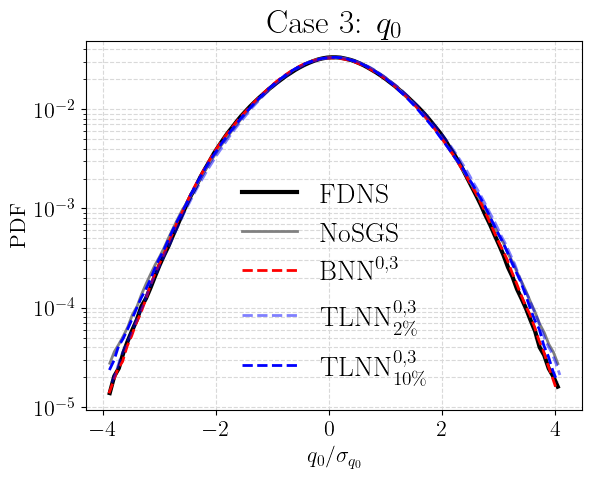

In [136]:
# plt.plot(pdf_q0_case4_hires.coords['q_0'].values, pdf_q0_case4_hires, label='High Resolution', color='black', linewidth=3)

# plt.plot(pdf_q0_case4_cnn.coords['q_0'].values, pdf_q0_case4_cnn, label=r'$BNN^{3}$', color='black', linewidth=2, linestyle='dashed')
plt.plot(pdf_q0_case4_fdns.coords['q_0'].values, pdf_q0_case4_fdns, label='FDNS', color='black', linewidth=3,linestyle='solid')
plt.plot(pdf_q0_case4_lores.coords['q_0'].values, pdf_q0_case4_lores, label='NoSGS', color='gray', linewidth=2)
plt.plot(pdf_q0_case4_bnn.coords['q_0'].values, pdf_q0_case4_bnn, label=r'$\mathrm{BNN}^{0,3} $', color='red', linestyle='dashed', linewidth=2)
plt.plot(pdf_q0_case4_tl2p.coords['q_0'].values, pdf_q0_case4_tl2p, label=r'$\mathrm{TLNN}^{0,3}_{2\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=0.5)
plt.plot(pdf_q0_case4_tl10p.coords['q_0'].values, pdf_q0_case4_tl10p, label=r'$\mathrm{TLNN}^{0,3}_{10\%}$', color='blue', linestyle='dashed', linewidth=2, alpha=1)


plt.grid(True, which="both", ls="--", color='0.85')
plt.title('Case 3: $q_0$', fontsize=24)
plt.yscale('log')
plt.xlabel(r'$q_0/\sigma_{q_0}$')
plt.ylabel(r'PDF')
# plt.xlim(-2, 2)
# plt.ylim(1e-3, 1e-1)
plt.legend(frameon=False, fontsize=20)
plt.show()